# Test 5; realistic scenario

import packages

In [1]:
from __future__ import annotations

%load_ext autoreload
%autoreload 2

import copy
import logging
import os
import pathlib
import pickle
import string

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scipy as sp
import verde as vd
import xarray as xr
from polartoolkit import maps, profiles
from polartoolkit import utils as polar_utils

import synthetic_bathymetry_inversion.plotting as synth_plotting
from synthetic_bathymetry_inversion import synthetic

os.environ["POLARTOOLKIT_HEMISPHERE"] = "south"

logging.getLogger().setLevel(logging.INFO)

from invert4geom import (
    inversion,
    optimization,
    plotting,
    regional,
    uncertainty,
    utils,
)
from invert4geom import synthetic as inv_synthetic

In [2]:
fpath = "../results/Ross_Sea/Ross_Sea_05"

# Get synthetic model data

INFO:polartoolkit:changing grid region, spacing and/or registration
INFO:polartoolkit:requested spacing (2000.0) larger than original (500.0), filtering before resampling
grdsample [WARNING]: Output sampling interval in x exceeds input interval and may lead to aliasing.
grdsample [WARNING]: Output sampling interval in y exceeds input interval and may lead to aliasing.
INFO:polartoolkit:converting to be reference to the WGS84 ellipsoid
INFO:polartoolkit:changing grid region, spacing and/or registration
INFO:polartoolkit:changing grid region, spacing and/or registration


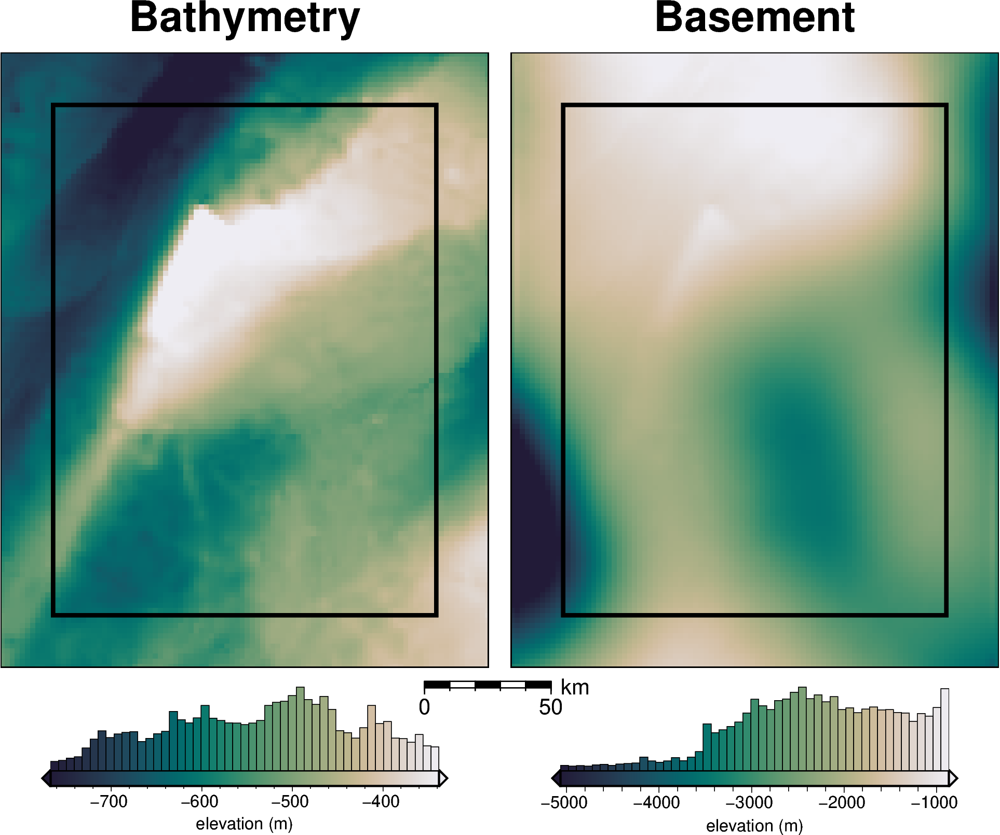

  0%|          | 0/7676 [00:00<?, ?it/s]

  0%|          | 0/7676 [00:00<?, ?it/s]

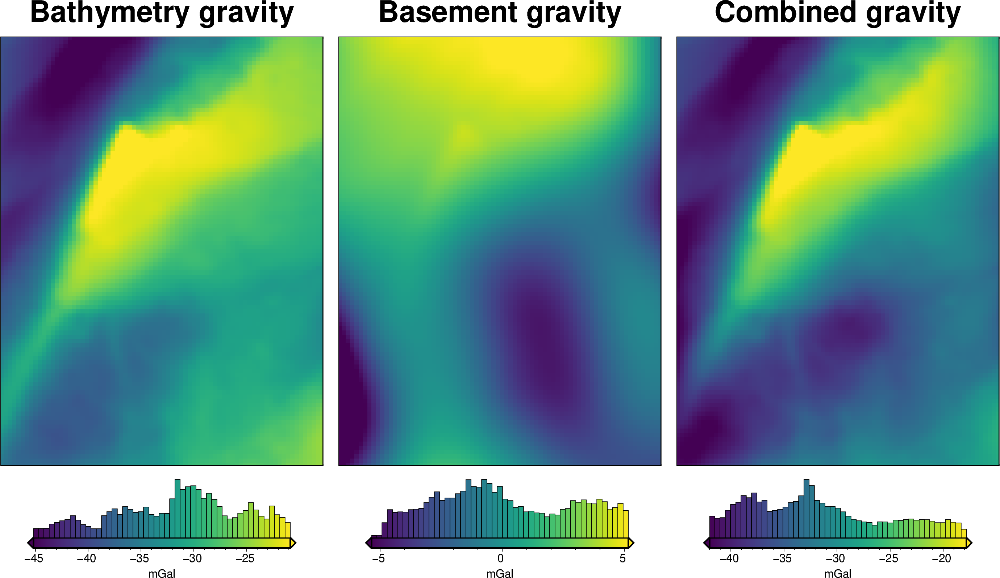

,northing,easting,upward,bathymetry_grav,basement_grav,disturbance,gravity_anomaly
0,-1600000.0,-40000.0,1000.0,-35.551085,-5.845685,-41.396770,-41.396770
1,-1600000.0,-38000.0,1000.0,-36.054683,-5.465801,-41.520485,-41.520485
2,-1600000.0,-36000.0,1000.0,-36.473168,-5.053773,-41.526941,-41.526941
3,-1600000.0,-34000.0,1000.0,-36.755627,-4.616487,-41.372114,-41.372114
4,-1600000.0,-32000.0,1000.0,-36.951045,-4.160973,-41.112018,-41.112018


In [3]:
# set grid parameters
spacing = 2e3
inversion_region = (-40e3, 110e3, -1600e3, -1400e3)

true_density_contrast = 1476

bathymetry, basement, grav_df = synthetic.load_synthetic_model(
    spacing=spacing,
    inversion_region=inversion_region,
    buffer=spacing * 10,
    basement=True,
    zref=0,
    bathymetry_density_contrast=true_density_contrast,
)
buffer_region = polar_utils.get_grid_info(bathymetry)[1]
grav_df.head()

In [4]:
reg = grav_df.basement_grav
reg -= reg.mean()
utils.rmse(reg)

np.float64(2.9630305782710358)

In [5]:
# normalize regional gravity between -1 and 1
grav_df["basement_grav_normalized"] = (
    vd.grid_to_table(
        utils.normalize_xarray(
            grav_df.set_index(["northing", "easting"]).to_xarray().basement_grav,
            low=-1,
            high=1,
        )
    )
    .reset_index()
    .basement_grav
)
grav_df = grav_df.drop(columns=["basement_grav", "disturbance", "gravity_anomaly"])

In [6]:
# re-scale the regional gravity
regional_grav = utils.normalize_xarray(
    grav_df.set_index(["northing", "easting"]).to_xarray().basement_grav_normalized,
    low=0,
    high=90,
).rename("basement_grav")
regional_grav -= regional_grav.mean()

# add to dataframe
grav_df["basement_grav"] = vd.grid_to_table(regional_grav).reset_index().basement_grav

# add basement and bathymetry forward gravities together to make observed gravity
grav_df["gravity_anomaly_full_res_no_noise"] = (
    grav_df.bathymetry_grav + grav_df.basement_grav
)

# add long-wavelength noise to the gravity anomaly
# gravity_noise=1 # 1 mGal after filtering gives .3 mGal RMSE
gravity_noise = 3  # 1 mGal after filtering gives .3 mGal RMSE

grav_df["gravity_anomaly_full_res"] = grav_df.gravity_anomaly_full_res_no_noise
cont = inv_synthetic.contaminate_with_long_wavelength_noise(
    grav_df.set_index(["northing", "easting"])
    .to_xarray()
    .gravity_anomaly_full_res_no_noise,
    coarsen_factor=None,
    spacing=2e3,
    noise_as_percent=False,
    noise=gravity_noise,
)
df = vd.grid_to_table(cont.rename("gravity_anomaly_full_res")).reset_index(drop=True)
grav_df = pd.merge(  # noqa: PD015
    grav_df.drop(columns=["gravity_anomaly_full_res"], errors="ignore"),
    df,
    on=["easting", "northing"],
)

# # short-wavelength noise
# cont = inv_synthetic.contaminate_with_long_wavelength_noise(
#     grav_df.set_index(["northing", "easting"]).to_xarray().gravity_anomaly_full_res,
#     coarsen_factor=None,
#     spacing=spacing, # * 2,
#     noise_as_percent=False,
#     noise=gravity_noise,
# )
# df = vd.grid_to_table(cont.rename("gravity_anomaly_full_res")).reset_index(drop=True)
# grav_df = pd.merge(
#     grav_df.drop(columns=["gravity_anomaly_full_res"], errors="ignore"),
#     df,
#     on=["easting", "northing"],
# )
grav_df["uncert"] = gravity_noise

new_reg = grav_df.set_index(["northing", "easting"]).to_xarray().basement_grav
new_reg -= new_reg.mean()
print(utils.rmse(new_reg))

grav_df

INFO:invert4geom:Standard deviation used for noise: [3.0]
INFO:polartoolkit:returning original grid


18.399757267227116


,northing,easting,upward,bathymetry_grav,basement_grav_normalized,basement_grav,gravity_anomaly_full_res_no_noise,gravity_anomaly_full_res,uncert
0,-1600000.0,-40000.0,1000.0,-35.551085,-0.575645,-36.300394,-71.851479,-72.911198,3
1,-1600000.0,-38000.0,1000.0,-36.054683,-0.523223,-33.941405,-69.996088,-72.483909,3
2,-1600000.0,-36000.0,1000.0,-36.473168,-0.466365,-31.382798,-67.855967,-68.870245,3
3,-1600000.0,-34000.0,1000.0,-36.755627,-0.406022,-28.667352,-65.422980,-61.536475,3
4,-1600000.0,-32000.0,1000.0,-36.951045,-0.343163,-25.838709,-62.789754,-65.528788,3
...,...,...,...,...,...,...,...,...,...
7671,-1400000.0,102000.0,1000.0,-25.760090,0.399167,7.566127,-18.193963,-19.271274,3
7672,-1400000.0,104000.0,1000.0,-25.911429,0.334798,4.669511,-21.241918,-24.226858,3
7673,-1400000.0,106000.0,1000.0,-26.032814,0.268741,1.696963,-24.335851,-19.966292,3
7674,-1400000.0,108000.0,1000.0,-26.121903,0.201716,-1.319170,-27.441073,-21.510609,3


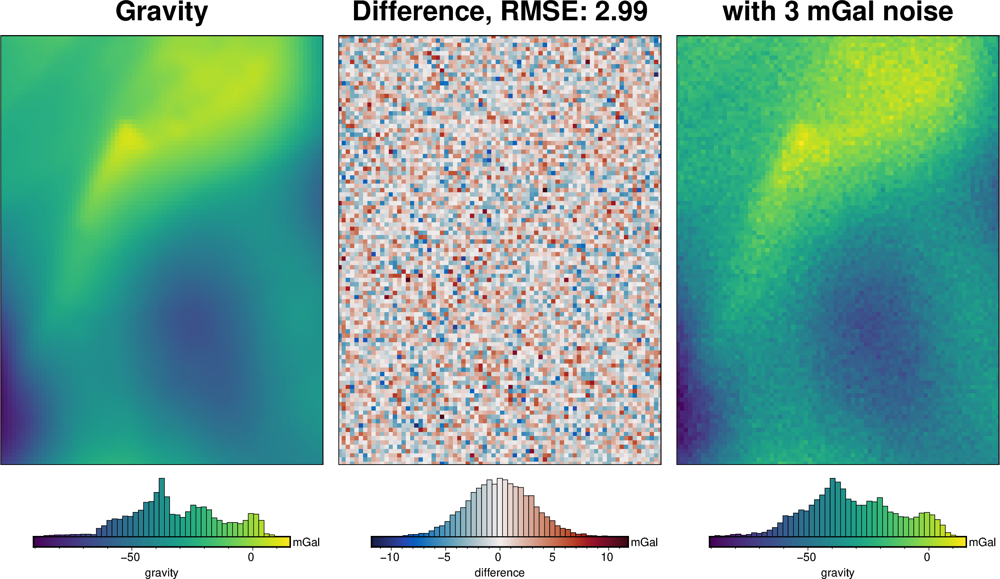

In [7]:
grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()

_ = polar_utils.grd_compare(
    grav_grid.gravity_anomaly_full_res_no_noise,
    grav_grid.gravity_anomaly_full_res,
    fig_height=10,
    plot=True,
    plot_type="pygmt",
    grid1_name="Gravity",
    grid2_name=f"with {gravity_noise} mGal noise",
    title="Difference",
    title_font="18p,Helvetica-Bold,black",
    cbar_unit="mGal",
    cbar_label="gravity",
    # RMSE_decimals=0,
    # robust=True,
    region=inversion_region,
    inset=False,
    hist=True,
    label_font="16p,Helvetica,black",
)

## Create synthetic airborne survey

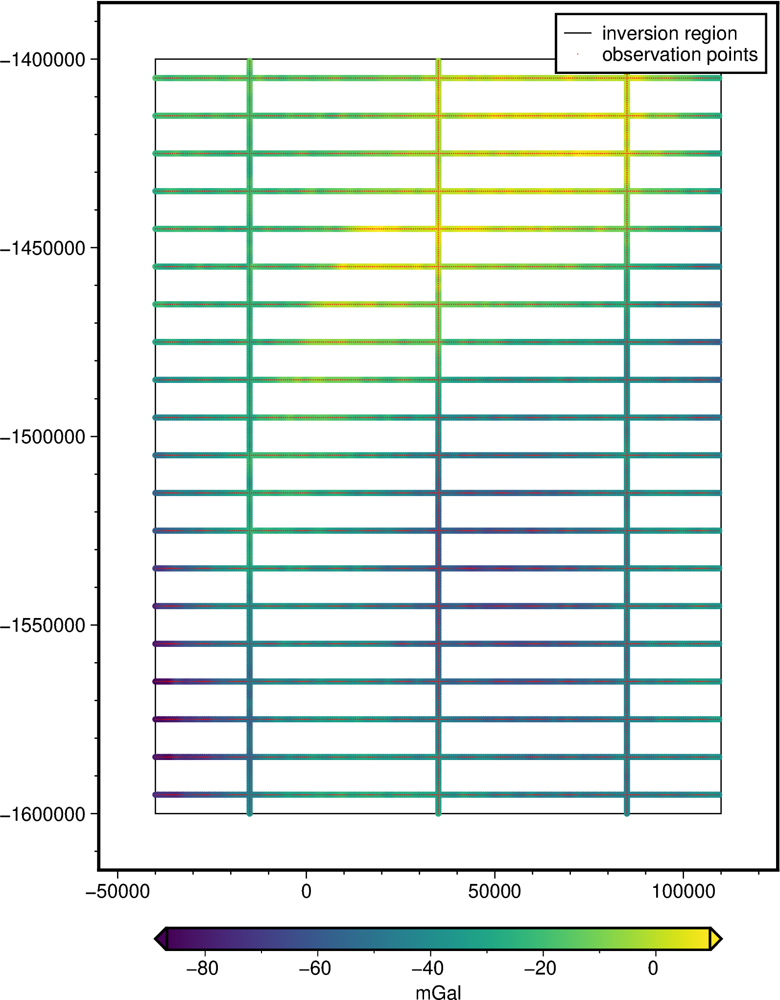

,northing,easting,upward,line,time,geometry,dist_along_line,gravity_anomaly,gravity_anomaly_unfilt
0,-1600000.0,-15000.0,1000.0,1000.0,0.0,POINT (-15000 -1600000),0.0,-38.318978,-38.318978
1,-1600000.0,35000.0,1000.0,1010.0,0.0,POINT (35000 -1600000),0.0,-27.055216,-27.055216
2,-1600000.0,85000.0,1000.0,1020.0,0.0,POINT (85000 -1600000),0.0,-41.147131,-41.147131
3,-1599500.0,-15000.0,1000.0,1000.0,1.0,POINT (-15000 -1599500),500.0,-39.712112,-39.712112
4,-1599500.0,35000.0,1000.0,1010.0,1.0,POINT (35000 -1599500),500.0,-28.659682,-28.659682
...,...,...,...,...,...,...,...,...,...
5995,-1405000.0,107500.0,1000.0,29.0,295.0,POINT (107500 -1405000),147500.0,-25.516940,-25.516940
5996,-1405000.0,108000.0,1000.0,29.0,296.0,POINT (108000 -1405000),148000.0,-25.615473,-25.615473
5997,-1405000.0,108500.0,1000.0,29.0,297.0,POINT (108500 -1405000),148500.0,-25.840151,-25.840151
5998,-1405000.0,109000.0,1000.0,29.0,298.0,POINT (109000 -1405000),149000.0,-26.102471,-26.102471


In [8]:
grav_survey_df = synthetic.airborne_survey(
    along_line_spacing=500,
    grav_observation_height=1e3,
    ns_line_spacing=50e3,
    ew_line_spacing=10e3,
    region=inversion_region,
    grav_grid=grav_df.set_index(
        ["northing", "easting"]
    ).gravity_anomaly_full_res.to_xarray(),
    plot=True,
)
grav_survey_df["gravity_anomaly_unfilt"] = grav_survey_df.gravity_anomaly

grav_survey_df

In [9]:
grav_survey_df = profiles.sample_grids(
    grav_survey_df,
    grav_df.set_index(
        ["northing", "easting"]
    ).gravity_anomaly_full_res_no_noise.to_xarray(),
    sampled_name="gravity_anomaly_no_noise",
)

In [10]:
synth_plotting.plotly_profiles(
    grav_survey_df[grav_survey_df.line == 29],
    x="dist_along_line",
    y=("gravity_anomaly_no_noise", "gravity_anomaly_unfilt"),
    title="Gravity anomaly profiles",
)

In [11]:
filter_widths = np.arange(0, 34e3, 2e3)
filter_widths

array([    0.,  2000.,  4000.,  6000.,  8000., 10000., 12000., 14000.,
       16000., 18000., 20000., 22000., 24000., 26000., 28000., 30000.,
       32000.])

In [12]:
dfs = []
difs = []

for f in filter_widths:
    survey_df = grav_survey_df.copy()

    if f == 0:
        survey_df["grav_anomaly_filt"] = survey_df.gravity_anomaly
        fig = None
        origin_shift = "initialize"
    else:
        survey_df["grav_anomaly_filt"] = synthetic.filter_flight_lines(
            survey_df,
            data_column="gravity_anomaly",
            filt_type=f"g{f}",
        )
        origin_shift = "x"

    survey_df["dif"] = survey_df.gravity_anomaly_no_noise - survey_df.grav_anomaly_filt

    difs.append(survey_df)

    dfs.append(
        pd.DataFrame(
            [
                {
                    "filt_width": f,
                    "rmse": utils.rmse(survey_df.dif),
                }
            ]
        )
    )
df = pd.concat(dfs, ignore_index=True)


# cpt_lims = polar_utils.get_combined_min_max([d.dif for d in difs], robust=True)

# for i, dif_df in enumerate(difs):
#     if i == 0:
#         fig=None
#         origin_shift="initialize"
#     else:
#         origin_shift="x"

#     fig = maps.basemap(
#         fig_height=10,
#         title=f"Filter width: {round(filter_widths[i]/1e3)} km",
#         region=inversion_region,
#         points=dif_df,
#         points_fill=dif_df.dif,
#         points_pen=None,
#         points_cmap="balance+h0",
#         points_style="c.1c",
#         hist=True,
#         cpt_lims=cpt_lims,
#         fig=fig,
#         origin_shift=origin_shift,
#     )

# fig.show()
df

,filt_width,rmse
0,0.0,2.167952
1,2000.0,2.088631
2,4000.0,1.904699
3,6000.0,1.705415
4,8000.0,1.534219
5,10000.0,1.398401
6,12000.0,1.293373
7,14000.0,1.213314
8,16000.0,1.153512
9,18000.0,1.110549


In [13]:
# save to a csv
df.to_csv(f"{fpath}_filter_width_rmse.csv", index=False)

Text(0.5, 1.0, 'Low-pass filtering of gravity data')

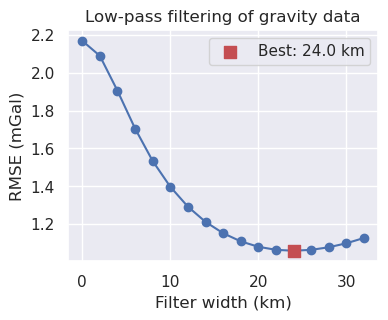

In [14]:
fig, ax = plt.subplots(figsize=(4, 3))
ax.plot(
    df.filt_width / 1e3,
    df.rmse,
    marker="o",
)

best_ind = df.rmse.idxmin()
ax.scatter(
    x=df.iloc[best_ind].filt_width / 1e3,
    y=df.iloc[best_ind].rmse,
    marker="s",
    color="r",
    s=80,
    zorder=20,
    label=f"Best: {round(df.iloc[best_ind].filt_width/1e3, 2)} km",
)
ax.legend()
ax.set_xlabel("Filter width (km)")
ax.set_ylabel("RMSE (mGal)")
ax.set_title("Low-pass filtering of gravity data")

In [15]:
filt_width = df.iloc[df.rmse.idxmin()].filt_width
# filt_width = 10e3
print(f"Filter width: {filt_width/1e3} km")

# filter each line in 1D with a Gaussian filter to remove some noise
grav_survey_df["gravity_anomaly"] = synthetic.filter_flight_lines(
    grav_survey_df,
    data_column="gravity_anomaly_unfilt",
    filt_type=f"g{filt_width}",
)

Filter width: 24.0 km


In [16]:
synth_plotting.plotly_profiles(
    grav_survey_df[grav_survey_df.line == 29],
    x="dist_along_line",
    y=("gravity_anomaly_no_noise", "gravity_anomaly", "gravity_anomaly_unfilt"),
    title="Gravity anomaly profiles",
)

In [17]:
# grid the airborne survey data over the whole grid
coords = (grav_survey_df.easting, grav_survey_df.northing, grav_survey_df.upward)
data = grav_survey_df.gravity_anomaly

eq_study, eqs = optimization.optimize_eq_source_params(
    coords,
    data,
    n_trials=12,
    damping_limits=(1e-4, 10),
    depth_limits=(100, 100e3),
    # damping=None,
    # depth="default",
    block_size=spacing,
    plot=True,
    fname=f"{fpath}_eq_sources",
)

INFO:invert4geom:using 8 startup trials


  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

INFO:invert4geom:Trial with best score: 
INFO:invert4geom:	trial number: 2
INFO:invert4geom:	parameter: {'depth': 10002.265810449084, 'damping': 0.00018602392746886265}
INFO:invert4geom:	scores: [0.9998988167127193]


In [18]:
# predict sources onto grid
grav_df["eqs_gravity_anomaly"] = eqs.predict(
    (
        grav_df.easting,
        grav_df.northing,
        grav_df.upward,  # either grav_df.upward or user-set constant value
    ),
)

grav_df["gravity_anomaly"] = grav_df.eqs_gravity_anomaly
grav_df

,northing,easting,upward,bathymetry_grav,basement_grav_normalized,basement_grav,gravity_anomaly_full_res_no_noise,gravity_anomaly_full_res,uncert,eqs_gravity_anomaly,gravity_anomaly
0,-1600000.0,-40000.0,1000.0,-35.551085,-0.575645,-36.300394,-71.851479,-72.911198,3,-64.481389,-64.481389
1,-1600000.0,-38000.0,1000.0,-36.054683,-0.523223,-33.941405,-69.996088,-72.483909,3,-64.163085,-64.163085
2,-1600000.0,-36000.0,1000.0,-36.473168,-0.466365,-31.382798,-67.855967,-68.870245,3,-63.178870,-63.178870
3,-1600000.0,-34000.0,1000.0,-36.755627,-0.406022,-28.667352,-65.422980,-61.536475,3,-61.636021,-61.636021
4,-1600000.0,-32000.0,1000.0,-36.951045,-0.343163,-25.838709,-62.789754,-65.528788,3,-59.623519,-59.623519
...,...,...,...,...,...,...,...,...,...,...,...
7671,-1400000.0,102000.0,1000.0,-25.760090,0.399167,7.566127,-18.193963,-19.271274,3,-15.904465,-15.904465
7672,-1400000.0,104000.0,1000.0,-25.911429,0.334798,4.669511,-21.241918,-24.226858,3,-18.079420,-18.079420
7673,-1400000.0,106000.0,1000.0,-26.032814,0.268741,1.696963,-24.335851,-19.966292,3,-20.010773,-20.010773
7674,-1400000.0,108000.0,1000.0,-26.121903,0.201716,-1.319170,-27.441073,-21.510609,3,-21.483911,-21.483911


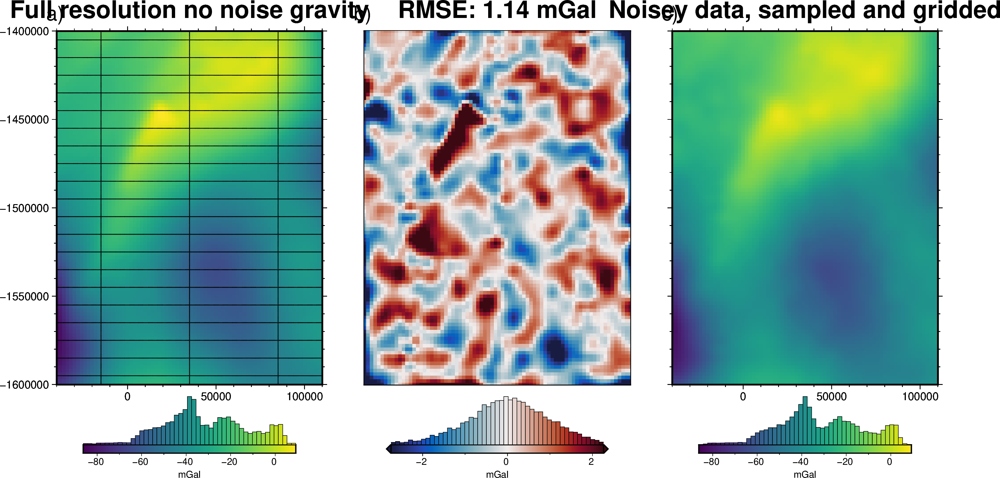

In [19]:
grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()

# plot the synthetic gravity anomaly grid
lims = polar_utils.get_min_max(grav_grid.gravity_anomaly_full_res_no_noise)

fig = maps.plot_grd(
    grav_grid.gravity_anomaly_full_res_no_noise,
    fig_height=10,
    cmap="viridis",
    cpt_lims=lims,
    title="Full resolution no noise gravity",
    cbar_label="mGal",
    frame=["nSWe", "xaf10000", "yaf10000"],
    hist=True,
)
# plot observation points
fig.plot(
    grav_survey_df[["easting", "northing"]],
    style="c.02c",
    fill="black",
)
fig.text(
    position="TL",
    justify="BL",
    text="a)",
    font="16p,Helvetica,black",
    offset="j-.3/.3",
    no_clip=True,
)

dif = grav_grid.gravity_anomaly_full_res_no_noise - grav_grid.gravity_anomaly
fig = maps.plot_grd(
    dif,
    fig_height=10,
    cmap="balance+h0",
    robust=True,
    title=f"RMSE: {round(utils.rmse(dif),2)} mGal",
    cbar_label="mGal",
    hist=True,
    fig=fig,
    origin_shift="xshift",
    xshift_amount=1.1,
)
fig.text(
    position="TL",
    justify="BL",
    text="b)",
    font="16p,Helvetica,black",
    offset="j-.3/.3",
    no_clip=True,
)

# plot the synthetic observed gravity grid
fig = maps.plot_grd(
    grav_grid.gravity_anomaly,
    fig_height=10,
    cmap="viridis",
    cpt_lims=lims,
    title="Noisey data, sampled and gridded",
    cbar_label="mGal",
    frame=["nSwe", "xaf10000", "yaf10000"],
    hist=True,
    fig=fig,
    origin_shift="xshift",
    xshift_amount=1.1,
)
fig.text(
    position="TL",
    justify="BL",
    text="c)",
    font="16p,Helvetica,black",
    offset="j-.3/.3",
    no_clip=True,
)
fig.show()

# Make starting bathymetry model

In [20]:
# semi-regularly spaced
constraint_points = synthetic.constraint_layout_number(
    shape=(6, 7),
    region=inversion_region,
    padding=-spacing,
    shapefile="../results/Ross_Sea_outline.shp",
    add_outside_points=True,
    grid_spacing=spacing,
)

# sample true topography at these points
constraint_points = utils.sample_grids(
    constraint_points,
    bathymetry,
    "true_upward",
    coord_names=("easting", "northing"),
)
constraint_points["upward"] = constraint_points.true_upward

constraint_points.describe()

,northing,easting,true_upward,upward
count,8.860000e+02,886.000000,886.000000,886.000000
mean,-1.500000e+06,35000.000000,-554.618624,-554.618624
std,7.943367e+04,62379.505946,110.436078,110.436078
min,-1.600000e+06,-40000.000000,-834.579102,-834.579102
25%,-1.589500e+06,-36000.000000,-652.470108,-652.470108
50%,-1.500000e+06,35000.000000,-549.707733,-549.707733
75%,-1.410500e+06,106000.000000,-453.898399,-453.898399
max,-1.400000e+06,110000.000000,-278.443117,-278.443117


In [21]:
# grid the sampled values using verde
starting_topography_kwargs = dict(
    method="splines",
    region=buffer_region,
    spacing=spacing,
    constraints_df=constraint_points,
    dampings=None,
)

starting_bathymetry = utils.create_topography(**starting_topography_kwargs)

starting_bathymetry

<xarray.DataArray 'scalars' (northing: 121, easting: 96)> Size: 93kB
array([[-541.24413863, -544.57181181, -547.92293683, ..., -360.00006252,
        -357.06767405, -354.19957764],
       [-543.34402682, -546.81675797, -550.35256327, ..., -362.90253223,
        -359.96874156, -357.11431884],
       [-545.05533616, -548.66036832, -552.37518157, ..., -365.66137903,
        -362.73269529, -359.90052822],
       ...,
       [-591.95335284, -595.51882201, -599.06869706, ..., -440.89315875,
        -440.6944619 , -440.40553782],
       [-590.53134834, -594.09076638, -597.64079289, ..., -440.69158328,
        -440.42525249, -440.07197234],
       [-589.16632672, -592.73504778, -596.3020968 , ..., -440.51760947,
        -440.1713932 , -439.74434037]], shape=(121, 96))
Coordinates:
  * easting   (easting) float64 768B -6e+04 -5.8e+04 ... 1.28e+05 1.3e+05
  * northing  (northing) float64 968B -1.62e+06 -1.618e+06 ... -1.38e+06
Attributes:
    metadata:  Generated by SplineCV(cv=KFold(n_splits=5, random_state=0, shu...
    damping:   None

In [22]:
# sample the inverted topography at the constraint points
constraint_points = utils.sample_grids(
    constraint_points,
    starting_bathymetry,
    "starting_bathymetry",
    coord_names=("easting", "northing"),
)

rmse = utils.rmse(constraint_points.true_upward - constraint_points.starting_bathymetry)
print(f"RMSE: {rmse:.2f} m")

RMSE: 0.03 m


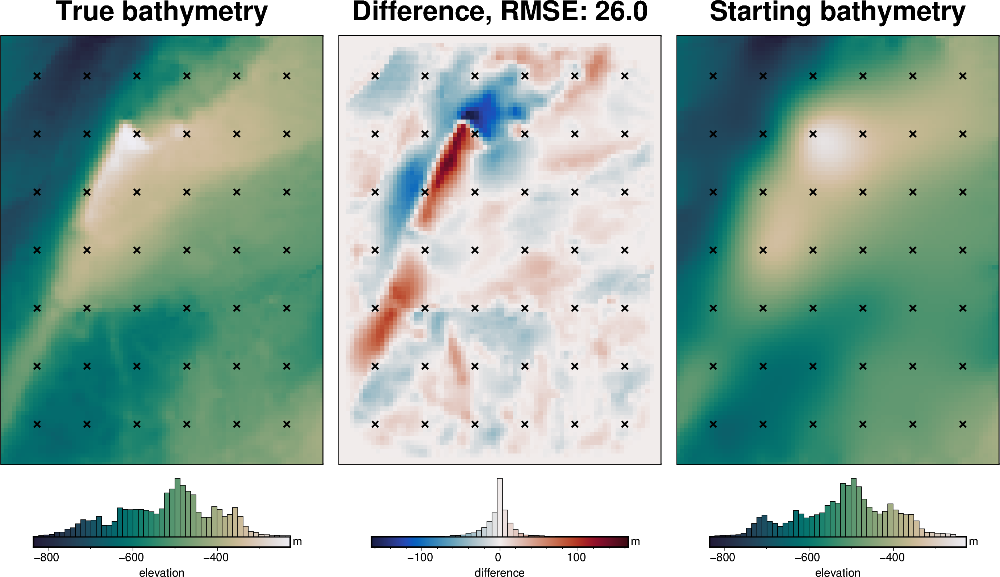

In [23]:
# compare starting and actual bathymetry grids
grids = polar_utils.grd_compare(
    bathymetry,
    starting_bathymetry,
    fig_height=10,
    plot=True,
    plot_type="pygmt",
    cmap="rain",
    reverse_cpt=True,
    diff_cmap="balance+h0",
    grid1_name="True bathymetry",
    grid2_name="Starting bathymetry",
    title="Difference",
    title_font="18p,Helvetica-Bold,black",
    cbar_unit="m",
    cbar_label="elevation",
    RMSE_decimals=0,
    region=inversion_region,
    inset=False,
    hist=True,
    label_font="16p,Helvetica,black",
    points=constraint_points[constraint_points.inside],
    points_style="x.2c",
)

In [24]:
# the true density contrast is 1476 kg/m3
density_contrast = 1350

# set the reference level from the prisms to 0
zref = 0

density_grid = xr.where(
    starting_bathymetry >= zref,
    density_contrast,
    -density_contrast,
)

# create layer of prisms
starting_prisms = utils.grids_to_prisms(
    starting_bathymetry,
    zref,
    density=density_grid,
)

grav_df["starting_gravity"] = starting_prisms.prism_layer.gravity(
    coordinates=(
        grav_df.easting,
        grav_df.northing,
        grav_df.upward,
    ),
    field="g_z",
    progressbar=True,
)

grav_df

  0%|          | 0/7676 [00:00<?, ?it/s]

,northing,easting,upward,bathymetry_grav,basement_grav_normalized,basement_grav,gravity_anomaly_full_res_no_noise,gravity_anomaly_full_res,uncert,eqs_gravity_anomaly,gravity_anomaly,starting_gravity
0,-1600000.0,-40000.0,1000.0,-35.551085,-0.575645,-36.300394,-71.851479,-72.911198,3,-64.481389,-64.481389,-32.541367
1,-1600000.0,-38000.0,1000.0,-36.054683,-0.523223,-33.941405,-69.996088,-72.483909,3,-64.163085,-64.163085,-32.965831
2,-1600000.0,-36000.0,1000.0,-36.473168,-0.466365,-31.382798,-67.855967,-68.870245,3,-63.178870,-63.178870,-33.347648
3,-1600000.0,-34000.0,1000.0,-36.755627,-0.406022,-28.667352,-65.422980,-61.536475,3,-61.636021,-61.636021,-33.644496
4,-1600000.0,-32000.0,1000.0,-36.951045,-0.343163,-25.838709,-62.789754,-65.528788,3,-59.623519,-59.623519,-33.840063
...,...,...,...,...,...,...,...,...,...,...,...,...
7671,-1400000.0,102000.0,1000.0,-25.760090,0.399167,7.566127,-18.193963,-19.271274,3,-15.904465,-15.904465,-23.321506
7672,-1400000.0,104000.0,1000.0,-25.911429,0.334798,4.669511,-21.241918,-24.226858,3,-18.079420,-18.079420,-23.482116
7673,-1400000.0,106000.0,1000.0,-26.032814,0.268741,1.696963,-24.335851,-19.966292,3,-20.010773,-20.010773,-23.605602
7674,-1400000.0,108000.0,1000.0,-26.121903,0.201716,-1.319170,-27.441073,-21.510609,3,-21.483911,-21.483911,-23.693171


# Regional misfit

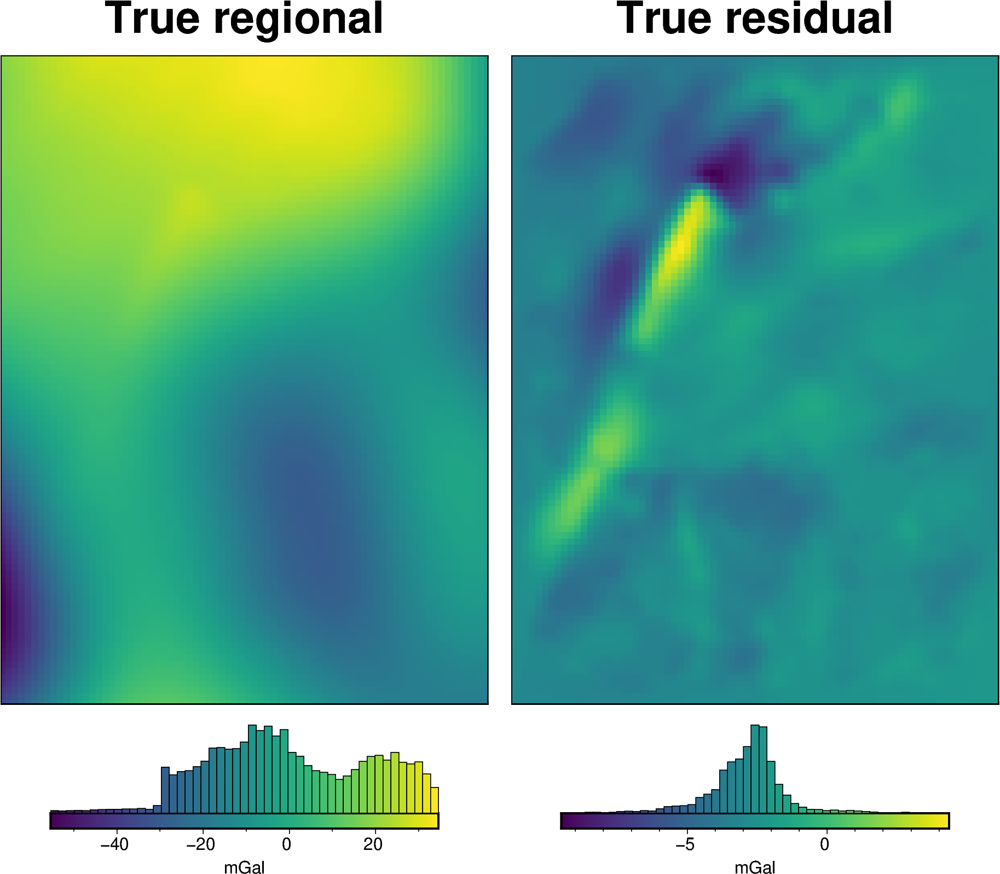

In [25]:
# calculate the true residual misfit
grav_df["true_res"] = grav_df.bathymetry_grav - grav_df.starting_gravity

# grid the results
grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()

fig = maps.plot_grd(
    grav_grid.basement_grav,
    fig_height=10,
    title="True regional",
    hist=True,
    cbar_label="mGal",
)

fig = maps.plot_grd(
    grav_grid.true_res,
    fig=fig,
    origin_shift="xshift",
    fig_height=10,
    title="True residual",
    hist=True,
    cbar_label="mGal",
)

fig.show()

In [26]:
def regional_comparison(df):
    # grid the results
    grav_grid = df.set_index(["northing", "easting"]).to_xarray()

    # calculate the true residual and regional misfit
    grav_grid["true_res"] = grav_grid.bathymetry_grav - grav_grid.starting_gravity
    # grav_grid["true_reg"] = grav_grid.gravity_anomaly - grav_grid.bathymetry_grav
    grav_grid["true_reg"] = grav_grid.basement_grav

    # compare with true regional
    _ = polar_utils.grd_compare(
        grav_grid.true_reg,  # -(grav_grid.true_reg.mean()-grav_grid.reg.mean()),
        grav_grid.reg,
        plot=True,
        grid1_name="True regional misfit",
        grid2_name="Regional misfit",
        hist=True,
        inset=False,
        verbose="q",
        title="difference",
        grounding_line=False,
        points=constraint_points,
        points_style="x.3c",
    )
    # compare with true residual
    _ = polar_utils.grd_compare(
        grav_grid.true_res,  # -(grav_grid.true_res.mean()-grav_grid.res.mean()),
        grav_grid.res,
        plot=True,
        grid1_name="True residual misfit",
        grid2_name="Residual misfit",
        cmap="balance+h0",
        hist=True,
        inset=False,
        verbose="q",
        title="difference",
        grounding_line=False,
        points=constraint_points,
        points_style="x.3c",
    )

In [27]:
# estimate regional with the constraints
regional_grav_kwargs = dict(
    method="constraints",
    grid_method="eq_sources",
    constraints_df=constraint_points,
    cv=True,
    cv_kwargs=dict(
        n_trials=20,
        # damping_limits=(1e-30, 10),
        depth_limits=(100, 600e3),
        progressbar=False,
        fname="../tmp_outputs/Ross_Sea_05_regional_sep",
    ),
    block_size=None,
    damping=None,
)

INFO:invert4geom:using 5 startup trials


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

INFO:invert4geom:Trial with best score: 
INFO:invert4geom:	trial number: 4
INFO:invert4geom:	parameter: {'depth': 209538.1557526367}
INFO:invert4geom:	scores: [0.9983886920414724]


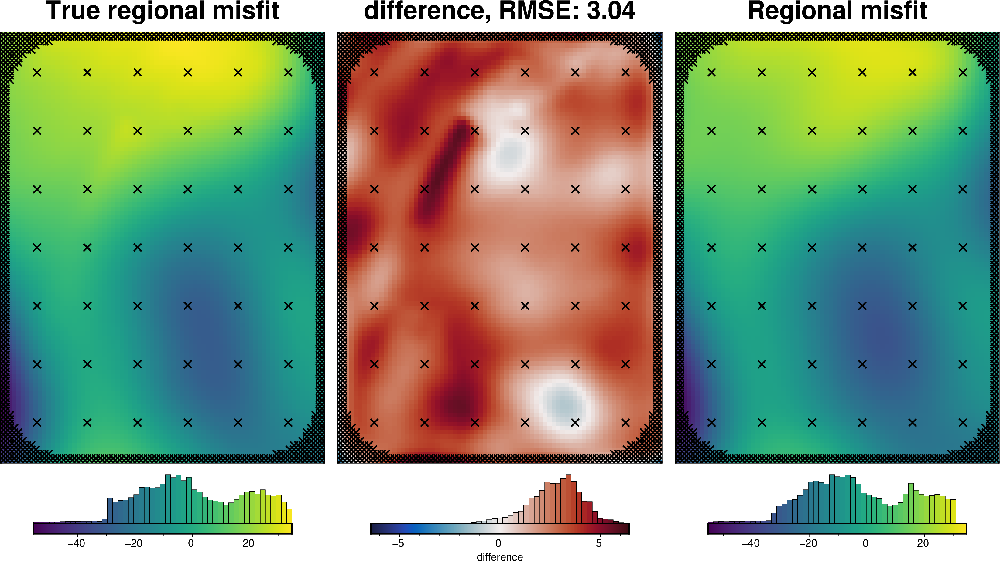

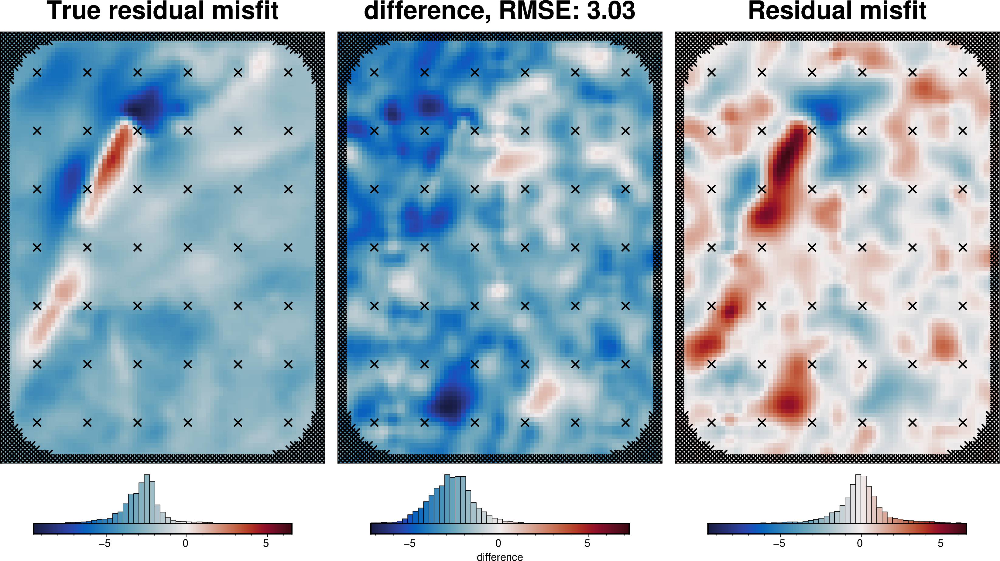

,northing,easting,upward,bathymetry_grav,basement_grav_normalized,basement_grav,gravity_anomaly_full_res_no_noise,gravity_anomaly_full_res,uncert,eqs_gravity_anomaly,gravity_anomaly,starting_gravity,true_res,misfit,reg,res
count,7.676000e+03,7676.000000,7676.0,7676.000000,7676.000000,7.676000e+03,7676.000000,7676.000000,7676.0,7676.000000,7676.000000,7676.000000,7676.000000,7676.000000,7676.000000,7676.000000
mean,-1.500000e+06,35000.000000,1000.0,-31.727282,0.231031,-2.843652e-15,-31.727282,-31.727282,3.0,-31.710141,-31.710141,-28.869499,-2.857784,-2.840642,-2.747802,-0.092840
std,5.831332e+04,43877.680138,0.0,6.458148,0.408910,1.840096e+01,18.705632,18.941873,0.0,18.538801,18.538801,5.735684,1.373353,18.070392,18.040082,1.573056
min,-1.600000e+06,-40000.000000,1000.0,-48.457772,-1.000000,-5.539638e+01,-86.255525,-90.659649,3.0,-83.807774,-83.807774,-44.455618,-9.507972,-55.631766,-55.108058,-7.264242
25%,-1.550000e+06,-2500.000000,1000.0,-36.286367,-0.073818,-1.371818e+01,-44.456648,-44.652752,3.0,-44.320756,-44.320756,-32.676771,-3.516046,-16.534486,-16.400733,-0.765958
50%,-1.500000e+06,35000.000000,1000.0,-31.030070,0.181838,-2.213682e+00,-34.787749,-33.948753,3.0,-34.918420,-34.918420,-28.426806,-2.725032,-5.028531,-5.172137,-0.068075
75%,-1.450000e+06,72500.000000,1000.0,-27.278975,0.596585,1.644995e+01,-18.710934,-18.463265,3.0,-18.422208,-18.422208,-24.769776,-2.210131,13.337093,13.745347,0.604106
max,-1.400000e+06,110000.000000,1000.0,-16.585798,1.000000,3.460362e+01,9.233507,15.492939,3.0,6.517515,6.517515,-15.540467,4.358587,32.748146,30.971930,6.508117


In [28]:
temp_reg_kwargs = copy.deepcopy(regional_grav_kwargs)

# temporarily set some kwargs
temp_reg_kwargs["cv_kwargs"]["plot"] = True
temp_reg_kwargs["cv_kwargs"]["progressbar"] = True

grav_df = regional.regional_separation(
    grav_df=grav_df,
    **temp_reg_kwargs,
)

regional_comparison(grav_df)
grav_df.describe()

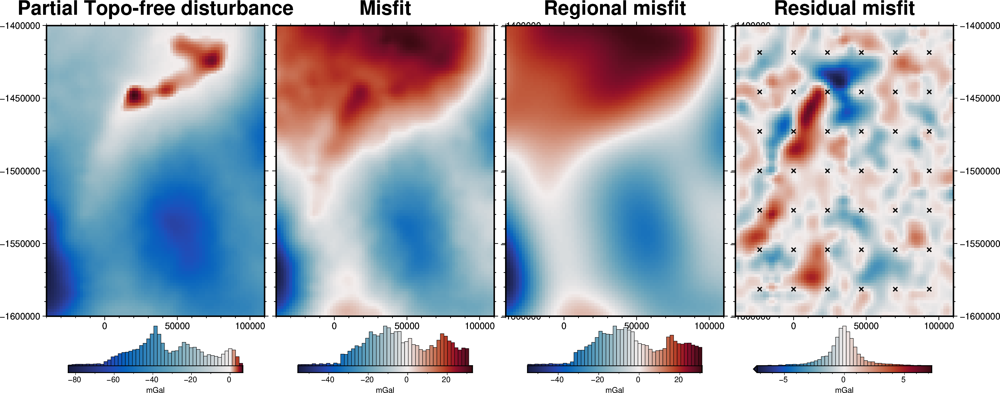

In [29]:
grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()

fig = maps.plot_grd(
    grav_grid.gravity_anomaly,
    region=inversion_region,
    fig_height=10,
    title="Partial Topo-free disturbance",
    cmap="balance+h0",
    hist=True,
    cbar_label="mGal",
    frame=["nSWe", "xaf10000", "yaf10000"],
)

fig = maps.plot_grd(
    grav_grid.misfit,
    region=inversion_region,
    fig=fig,
    origin_shift="xshift",
    fig_height=10,
    title="Misfit",
    cmap="balance+h0",
    hist=True,
    cbar_label="mGal",
    frame=["nSwE", "xaf10000", "yaf10000"],
)

fig = maps.plot_grd(
    grav_grid.reg,
    region=inversion_region,
    fig=fig,
    origin_shift="xshift",
    fig_height=10,
    title="Regional misfit",
    cmap="balance+h0",
    hist=True,
    cbar_label="mGal",
    frame=["nSwE", "xaf10000", "yaf10000"],
)

fig = maps.plot_grd(
    grav_grid.res,
    region=inversion_region,
    fig=fig,
    origin_shift="xshift",
    fig_height=10,
    title="Residual misfit",
    cmap="balance+h0",
    cpt_lims=[-vd.maxabs(grav_grid.res), vd.maxabs(grav_grid.res)],
    hist=True,
    cbar_label="mGal",
    frame=["nSwE", "xaf10000", "yaf10000"],
    points=constraint_points[constraint_points.inside],
    points_style="x.2c",
)
fig.show()

In [30]:
grav_df.uncert.mean()

np.float64(3.0)

In [31]:
# set kwargs to pass to the inversion
kwargs = {
    # set stopping criteria
    "max_iterations": 200,
    "l2_norm_tolerance": grav_df.uncert.mean() ** 0.5,  # square root of the noise
    "delta_l2_norm_tolerance": 1.008,
}

# Damping Cross Validation

In [32]:
logging.getLogger().setLevel(logging.INFO)

# run the inversion workflow, including a cross validation for the damping parameter
results = inversion.run_inversion_workflow(
    grav_df=grav_df,
    starting_prisms=starting_prisms,
    # for creating test/train splits
    grav_spacing=spacing,
    inversion_region=inversion_region,
    run_damping_cv=True,
    damping_limits=(0.001, 0.1),
    damping_cv_trials=8,
    # plot_cv=True,
    fname=f"{fpath}_damping_cv",
    **kwargs,
)

INFO:invert4geom:saving all results with root name '../results/Ross_Sea/Ross_Sea_05_damping_cv'
INFO:invert4geom:running damping cross validation
INFO:invert4geom:using 4 startup trials


  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

INFO:invert4geom:Trial with best score: 
INFO:invert4geom:	trial number: 7
INFO:invert4geom:	parameter: {'damping': 0.013422423312811651}
INFO:invert4geom:	scores: [0.020535385530815173]
INFO:invert4geom:results saved to ../results/Ross_Sea/Ross_Sea_05_damping_cv_results.pickle.pickle


In [33]:
# load saved inversion results
with pathlib.Path(f"{fpath}_damping_cv_results.pickle").open("rb") as f:
    results = pickle.load(f)

# load study
with pathlib.Path(f"{fpath}_damping_cv_damping_cv_study.pickle").open("rb") as f:
    study = pickle.load(f)

# collect the results
topo_results, grav_results, parameters, elapsed_time = results

In [34]:
best_damping = parameters.get("Solver damping")
kwargs["solver_damping"] = best_damping
best_damping

0.013422423312811651

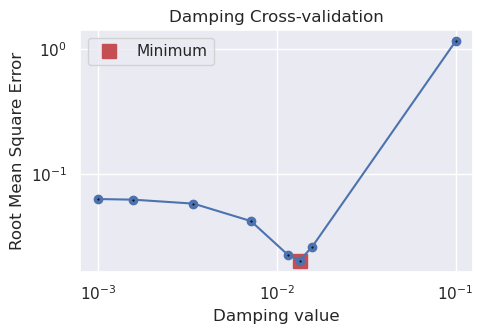

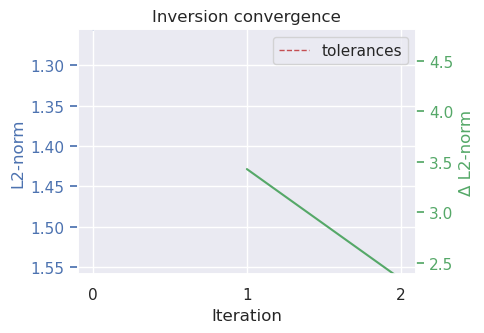

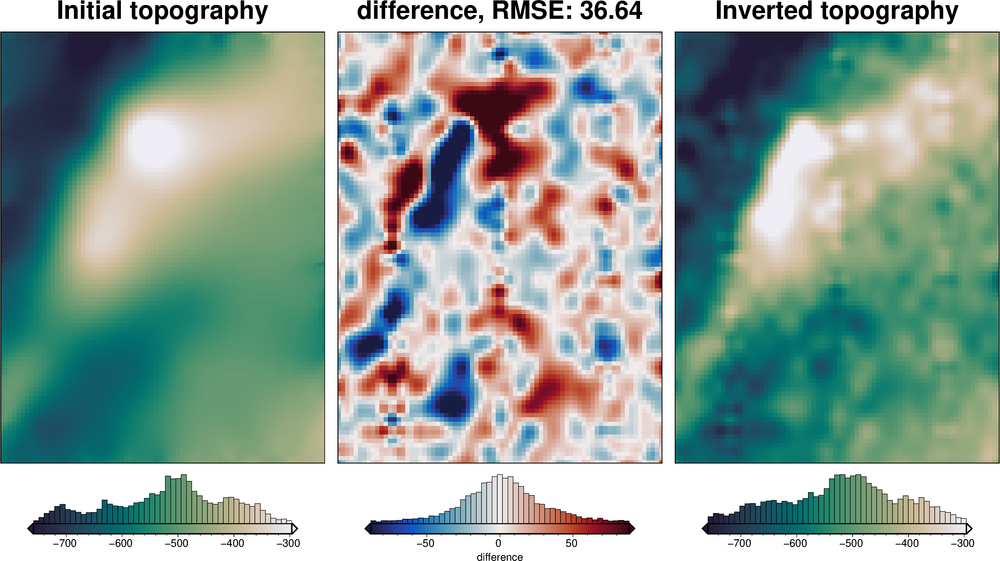

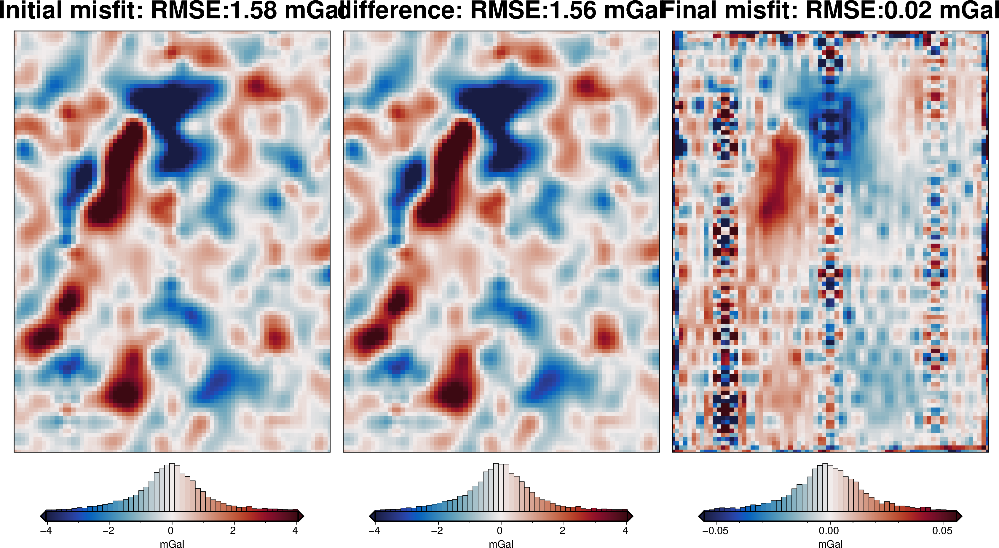

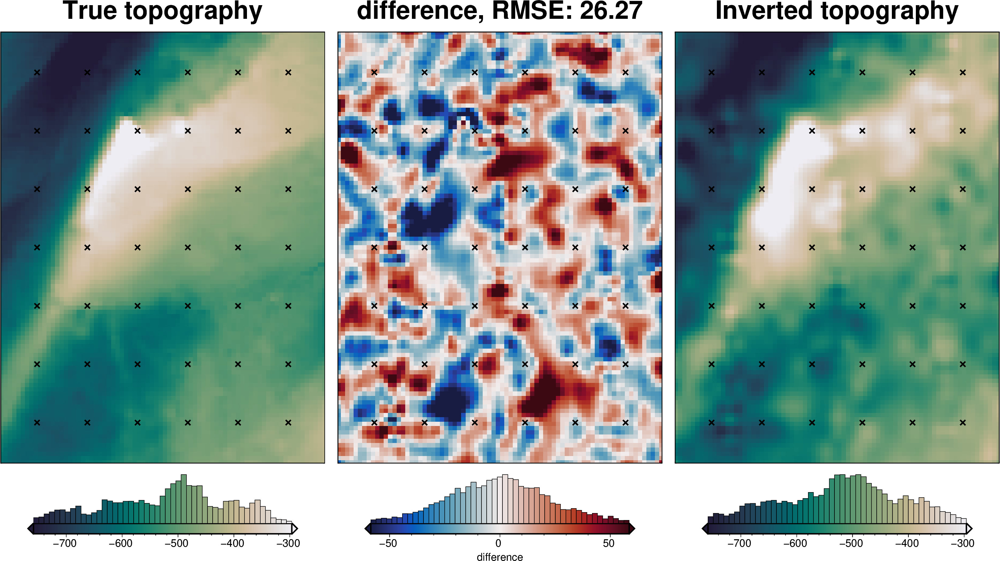

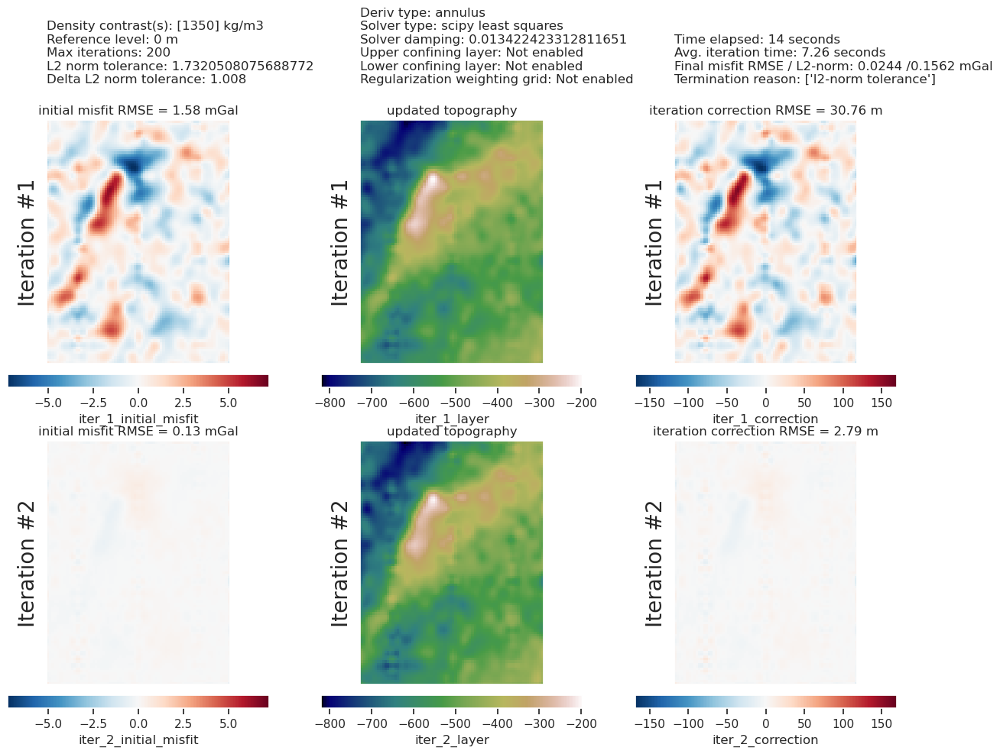

In [35]:
study_df = study.trials_dataframe()

plotting.plot_cv_scores(
    study_df.value,
    study_df.params_damping,
    param_name="Damping",
    logx=True,
    logy=True,
)

plotting.plot_convergence(
    grav_results,
    params=parameters,
)

plotting.plot_inversion_results(
    grav_results,
    topo_results,
    parameters,
    inversion_region,
    iters_to_plot=2,
    plot_iter_results=True,
    plot_topo_results=True,
    plot_grav_results=True,
)

final_topography = topo_results.set_index(["northing", "easting"]).to_xarray().topo

_ = polar_utils.grd_compare(
    bathymetry,
    final_topography,
    region=inversion_region,
    plot=True,
    grid1_name="True topography",
    grid2_name="Inverted topography",
    robust=True,
    hist=True,
    inset=False,
    verbose="q",
    title="difference",
    grounding_line=False,
    reverse_cpt=True,
    cmap="rain",
    points=constraint_points[constraint_points.inside],
    points_style="x.2c",
)

In [36]:
# sample the inverted topography at the constraint points
constraint_points = utils.sample_grids(
    constraint_points,
    final_topography,
    "inverted_topography",
    coord_names=("easting", "northing"),
)

rmse = utils.rmse(constraint_points.true_upward - constraint_points.inverted_topography)
print(f"RMSE: {rmse:.2f} m")

RMSE: 21.34 m


# Density CV

INFO:invert4geom:using 4 startup trials


  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

INFO:invert4geom:Trial with best score: 
INFO:invert4geom:	trial number: 5
INFO:invert4geom:	parameter: {'density_contrast': 2290}
INFO:invert4geom:	scores: [357.47666041143185]


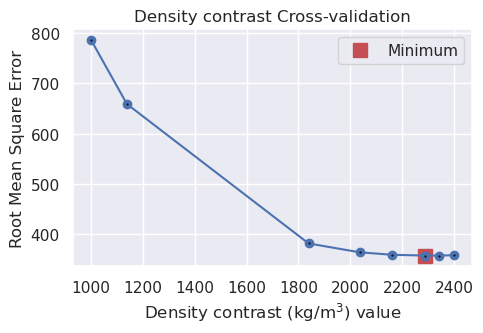

In [37]:
# run the cross validation for density
study, inversion_results = optimization.optimize_inversion_zref_density_contrast(
    grav_df=grav_df,
    constraints_df=constraint_points,  # [constraint_points.inside],
    density_contrast_limits=(1000, 2400),
    zref=0,
    n_trials=8,
    starting_topography=starting_bathymetry,
    regional_grav_kwargs=dict(
        method="constant",
        constant=0,
    ),
    fname=f"{fpath}_density_cv",
    **kwargs,
)

INFO:invert4geom:Constraints split into 4 folds
INFO:invert4geom:using 4 startup trials


  0%|          | 0/4 [00:00<?, ?it/s]

INFO:invert4geom:starting_topography not provided, creating a starting topography model with the supplied starting_topography_kwargs


  0%|          | 0/8 [00:00<?, ?it/s]

INFO:invert4geom:starting_topography not provided, creating a starting topography model with the supplied starting_topography_kwargs
INFO:invert4geom:Trial with best score: 
INFO:invert4geom:	trial number: 11
INFO:invert4geom:	parameter: {'density_contrast': 2025}
INFO:invert4geom:	scores: [38.67932442162952]


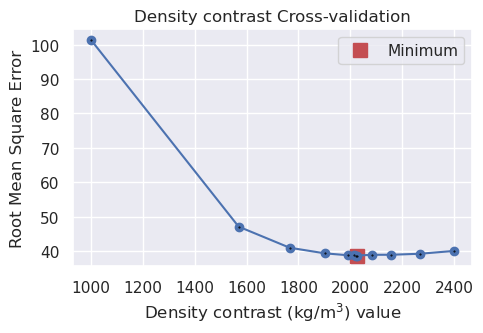

In [38]:
# run a 5-fold cross validation for 10 parameter sets of density
# this performs 50 regional separations and 50 inversions
study, inversion_results = optimization.optimize_inversion_zref_density_contrast_kfolds(
    grav_df=grav_df,
    constraints_df=constraint_points[constraint_points.inside],
    density_contrast_limits=(1000, 2400),
    zref=0,
    n_trials=12,
    # n_startup_trials=6,
    split_kwargs=dict(
        n_splits=4,
        method="KFold",
    ),
    seed=2,
    regional_grav_kwargs=regional_grav_kwargs,
    starting_topography_kwargs=starting_topography_kwargs,
    fname=f"{fpath}_density_cv_kfolds",
    fold_progressbar=False,
    **kwargs,
)

In [39]:
# load study from normal optimization
with pathlib.Path(f"{fpath}_density_cv_study.pickle").open("rb") as f:
    study = pickle.load(f)
    optimized_density = study.best_params["density_contrast"]

# load study from kfold optimization
with pathlib.Path(f"{fpath}_density_cv_kfolds_study.pickle").open("rb") as f:
    study = pickle.load(f)
    kfold_optimized_density = study.best_params["density_contrast"]

print("optimal density contrast from normal optimization: ", optimized_density)
print("optimal density contrast from K-folds optimization: ", kfold_optimized_density)
print("real density contrast", true_density_contrast)

best_density_contrast = min(
    [optimized_density, kfold_optimized_density],
    key=lambda x: abs(x - true_density_contrast),
)

optimal density contrast from normal optimization:  2290
optimal density contrast from K-folds optimization:  2025
real density contrast 1476


In [40]:
print("optimal determined density contrast", best_density_contrast)
print("real density contrast", true_density_contrast)
print("density error", best_density_contrast - true_density_contrast)

optimal determined density contrast 2025
real density contrast 1476
density error 549


### Redo with optimal density contrast
During the density cross-validation to avoid biasing the scores, we had to manually set a regional field. Now, with the optimal density contrast value found, we can rerun the inversion with an automatically determined regional field strength (the average value misfit at the constraints).

  0%|          | 0/7676 [00:00<?, ?it/s]

INFO:invert4geom:using 5 startup trials
INFO:invert4geom:Trial with best score: 
INFO:invert4geom:	trial number: 5
INFO:invert4geom:	parameter: {'depth': 272567.6395660266}
INFO:invert4geom:	scores: [0.9984622703510085]


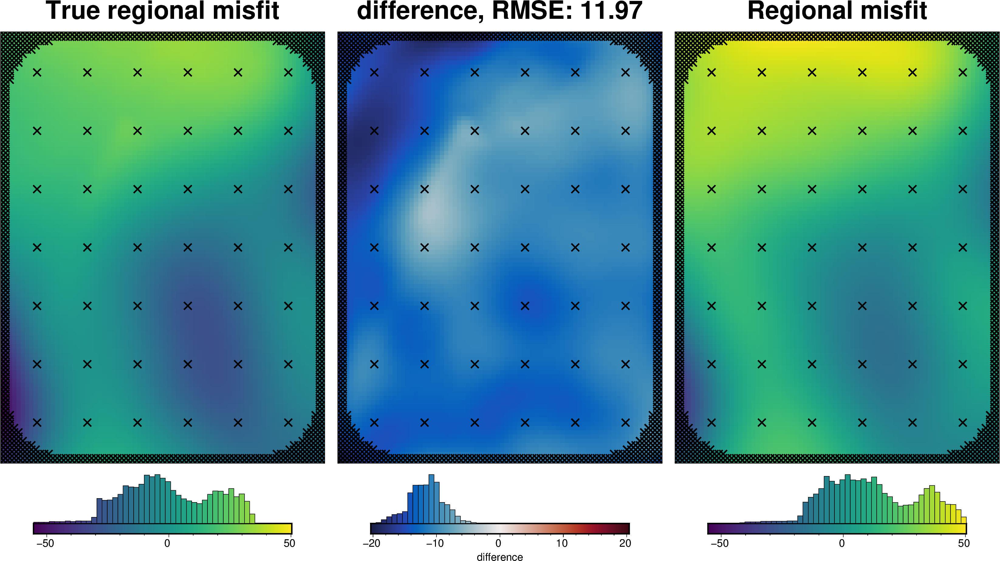

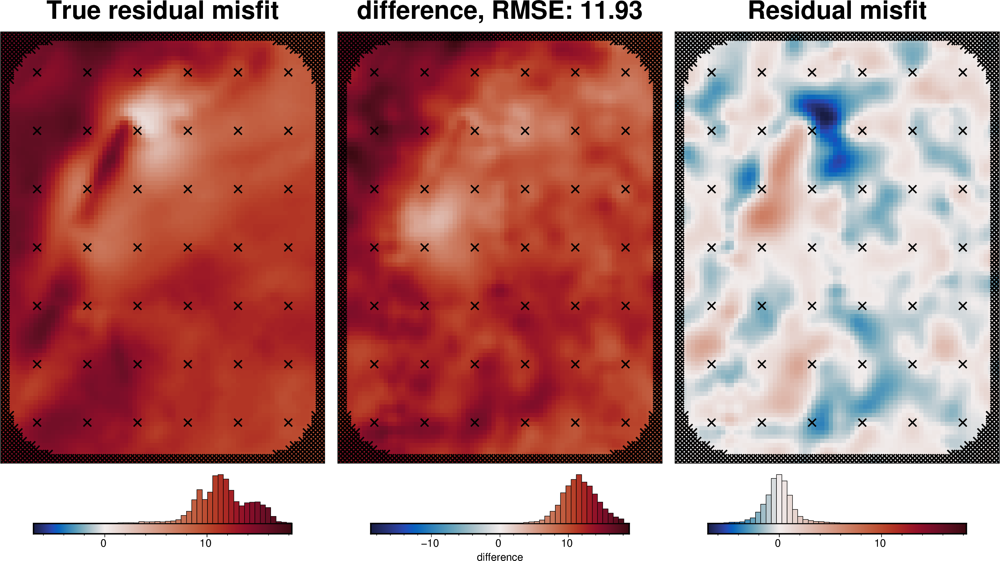

In [41]:
density_contrast = best_density_contrast

density_grid = xr.where(
    starting_bathymetry >= zref,
    density_contrast,
    -density_contrast,
)
# create layer of prisms
starting_prisms = utils.grids_to_prisms(
    starting_bathymetry,
    zref,
    density=density_grid,
)
grav_df["starting_gravity"] = starting_prisms.prism_layer.gravity(
    coordinates=(
        grav_df.easting,
        grav_df.northing,
        grav_df.upward,
    ),
    field="g_z",
    progressbar=True,
)

grav_df = regional.regional_separation(
    grav_df=grav_df,
    **regional_grav_kwargs,
)

regional_comparison(grav_df)

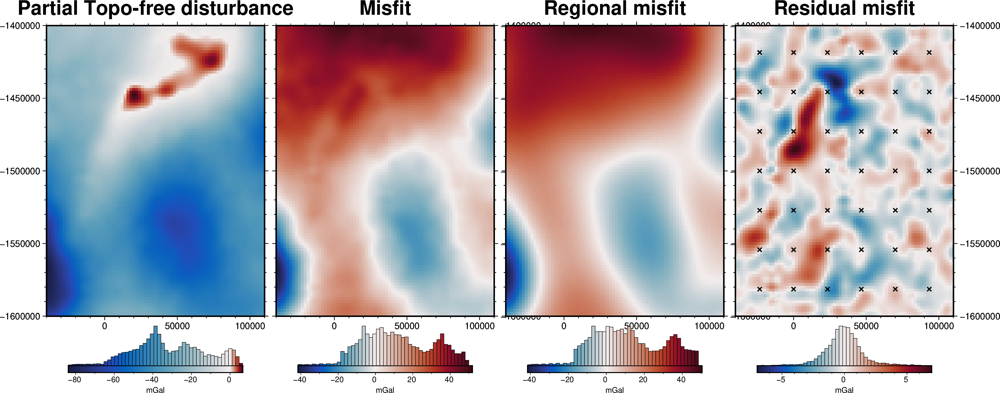

In [42]:
grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()

fig = maps.plot_grd(
    grav_grid.gravity_anomaly,
    region=inversion_region,
    fig_height=10,
    title="Partial Topo-free disturbance",
    cmap="balance+h0",
    hist=True,
    cbar_label="mGal",
    frame=["nSWe", "xaf10000", "yaf10000"],
)

fig = maps.plot_grd(
    grav_grid.misfit,
    region=inversion_region,
    fig=fig,
    origin_shift="xshift",
    fig_height=10,
    title="Misfit",
    cmap="balance+h0",
    hist=True,
    cbar_label="mGal",
    frame=["nSwE", "xaf10000", "yaf10000"],
)

fig = maps.plot_grd(
    grav_grid.reg,
    region=inversion_region,
    fig=fig,
    origin_shift="xshift",
    fig_height=10,
    title="Regional misfit",
    cmap="balance+h0",
    hist=True,
    cbar_label="mGal",
    frame=["nSwE", "xaf10000", "yaf10000"],
)

fig = maps.plot_grd(
    grav_grid.res,
    region=inversion_region,
    fig=fig,
    origin_shift="xshift",
    fig_height=10,
    title="Residual misfit",
    cmap="balance+h0",
    cpt_lims=[-vd.maxabs(grav_grid.res), vd.maxabs(grav_grid.res)],
    hist=True,
    cbar_label="mGal",
    frame=["nSwE", "xaf10000", "yaf10000"],
    points=constraint_points[constraint_points.inside],
    points_style="x.2c",
)
fig.show()

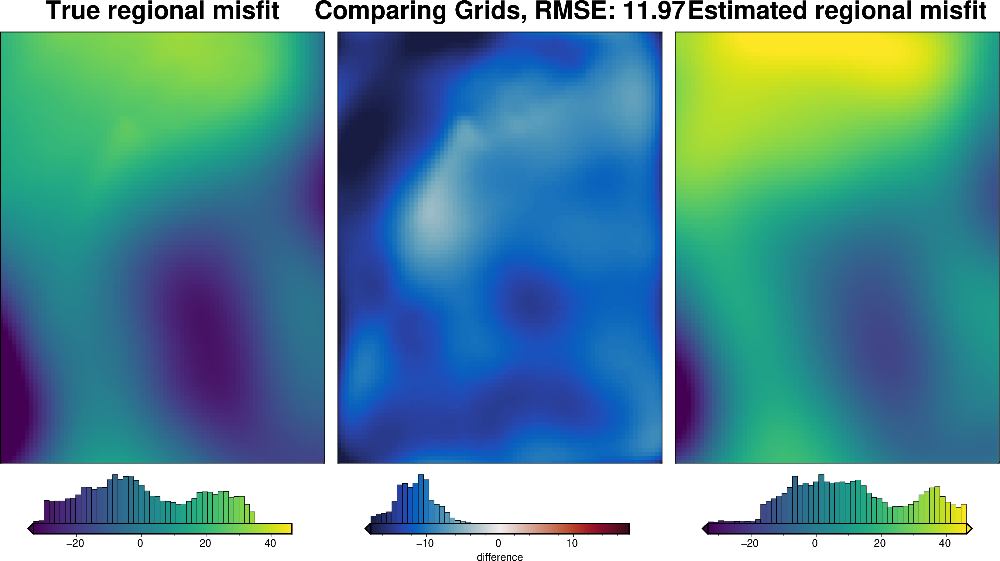

In [43]:
_ = polar_utils.grd_compare(
    grav_grid.basement_grav,
    grav_grid.reg,
    plot=True,
    inset=False,
    robust=True,
    grid1_name="True regional misfit",
    grid2_name="Estimated regional misfit",
    hist=True,
)

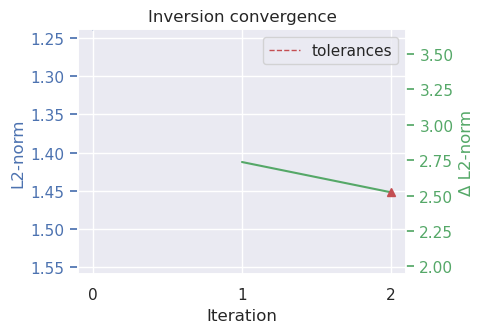

In [44]:
# run the inversion workflow
inversion_results = inversion.run_inversion_workflow(
    grav_df=grav_df,
    fname=f"{fpath}_optimal",
    starting_prisms=starting_prisms,
    plot_dynamic_convergence=True,
    **kwargs,
)

In [45]:
# load saved inversion results
with pathlib.Path(f"{fpath}_optimal_results.pickle").open("rb") as f:
    results = pickle.load(f)

# collect the results
topo_results, grav_results, parameters, elapsed_time = results

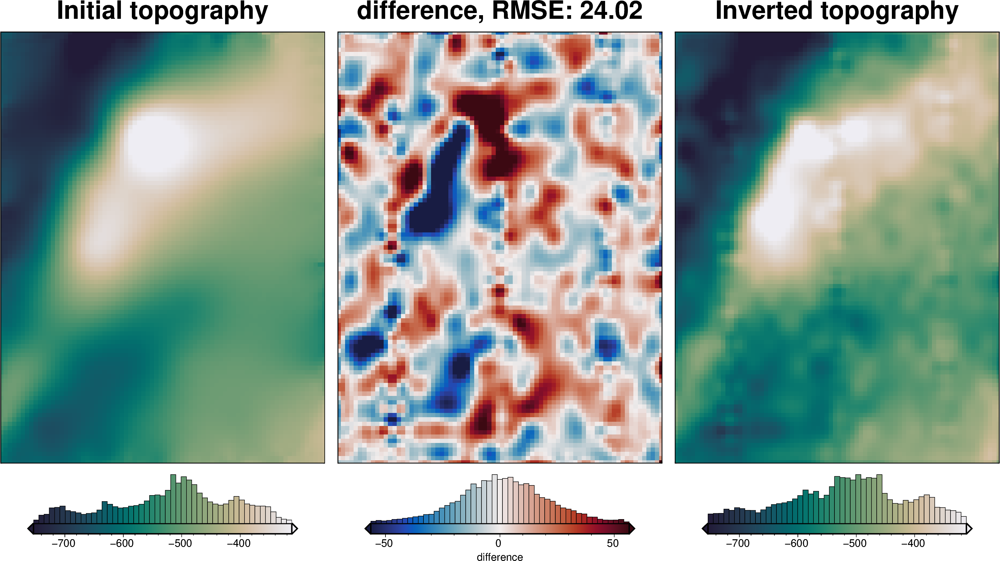

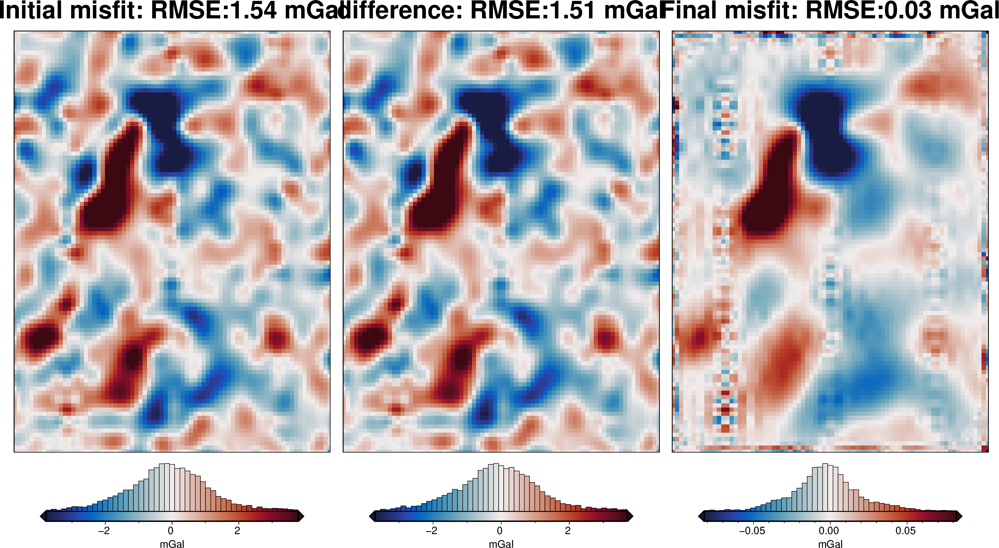

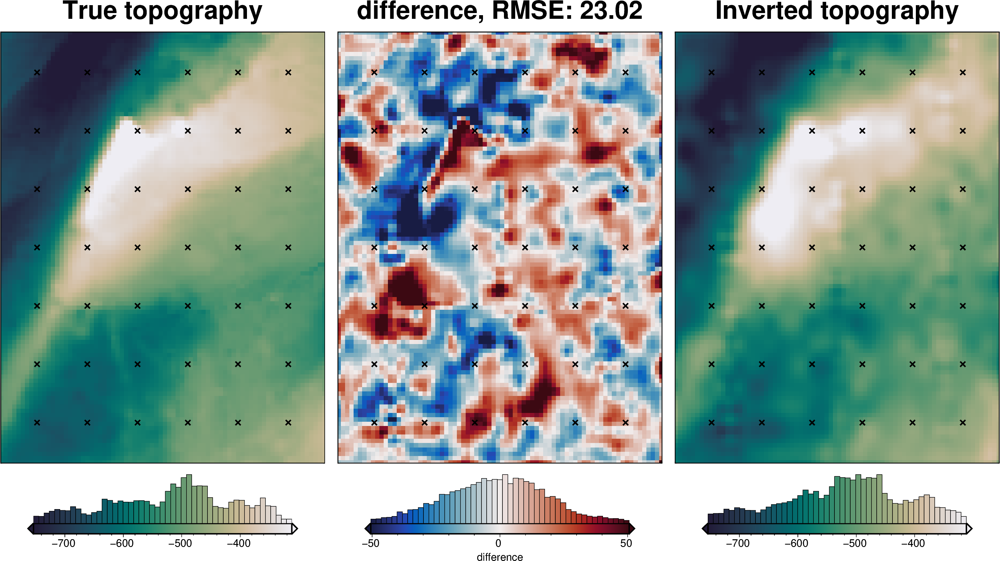

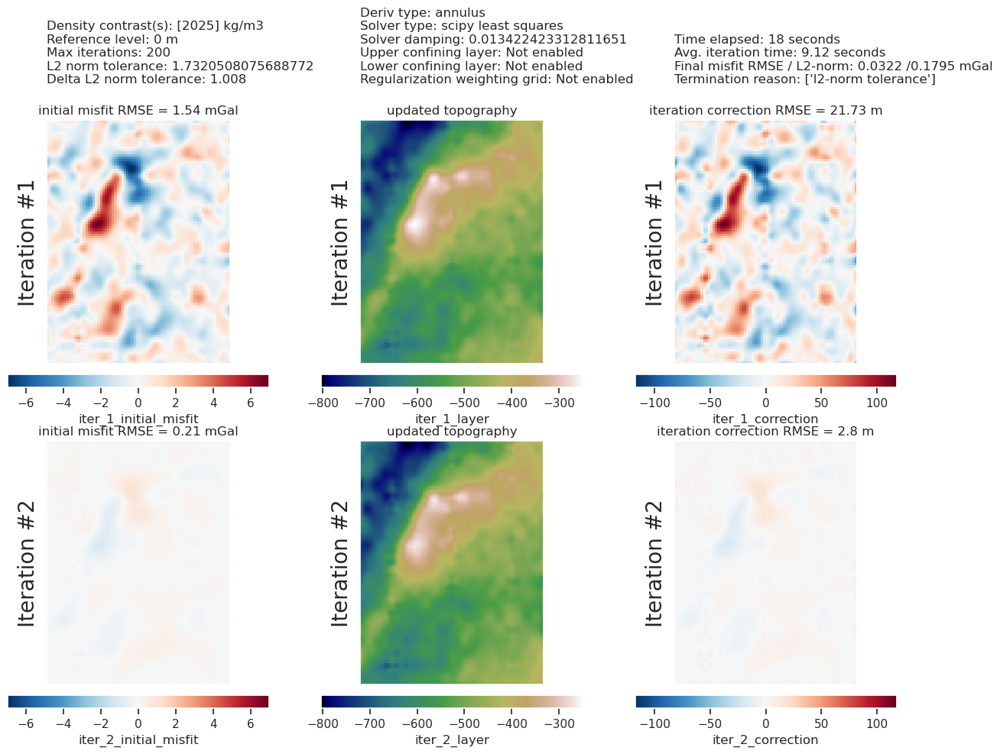

In [46]:
plotting.plot_inversion_results(
    grav_results,
    topo_results,
    parameters,
    inversion_region,
    iters_to_plot=2,
    plot_iter_results=True,
    plot_topo_results=True,
    plot_grav_results=True,
)

final_topography = topo_results.set_index(["northing", "easting"]).to_xarray().topo

_ = polar_utils.grd_compare(
    bathymetry,
    final_topography,
    region=inversion_region,
    plot=True,
    grid1_name="True topography",
    grid2_name="Inverted topography",
    robust=True,
    hist=True,
    inset=False,
    verbose="q",
    title="difference",
    grounding_line=False,
    reverse_cpt=True,
    cmap="rain",
    points=constraint_points[constraint_points.inside],
    points_style="x.2c",
)

In [47]:
# sample the inverted topography at the constraint points
constraint_points = utils.sample_grids(
    constraint_points,
    final_topography,
    "inverted_topography",
    coord_names=("easting", "northing"),
)

rmse = utils.rmse(constraint_points.true_upward - constraint_points.inverted_topography)
print(f"RMSE: {rmse:.2f} m")

RMSE: 17.66 m


In [48]:
# save to csv
constraint_points.to_csv(f"{fpath}_constraint_points.csv", index=False)

# Redo regional separation with true density

  0%|          | 0/7676 [00:00<?, ?it/s]

INFO:invert4geom:using 5 startup trials


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

INFO:invert4geom:Trial with best score: 
INFO:invert4geom:	trial number: 4
INFO:invert4geom:	parameter: {'depth': 209538.1557526367}
INFO:invert4geom:	scores: [0.9984188722468266]


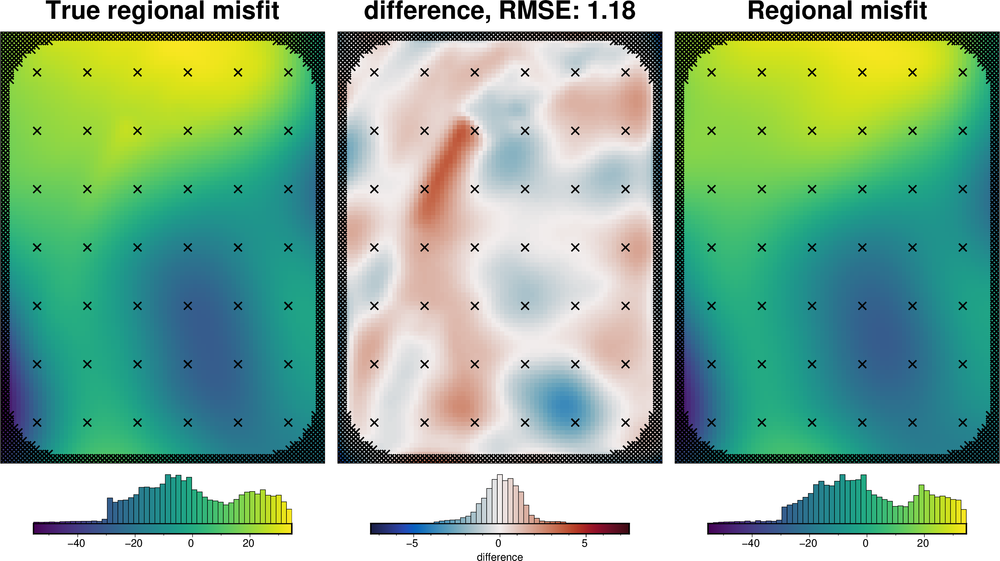

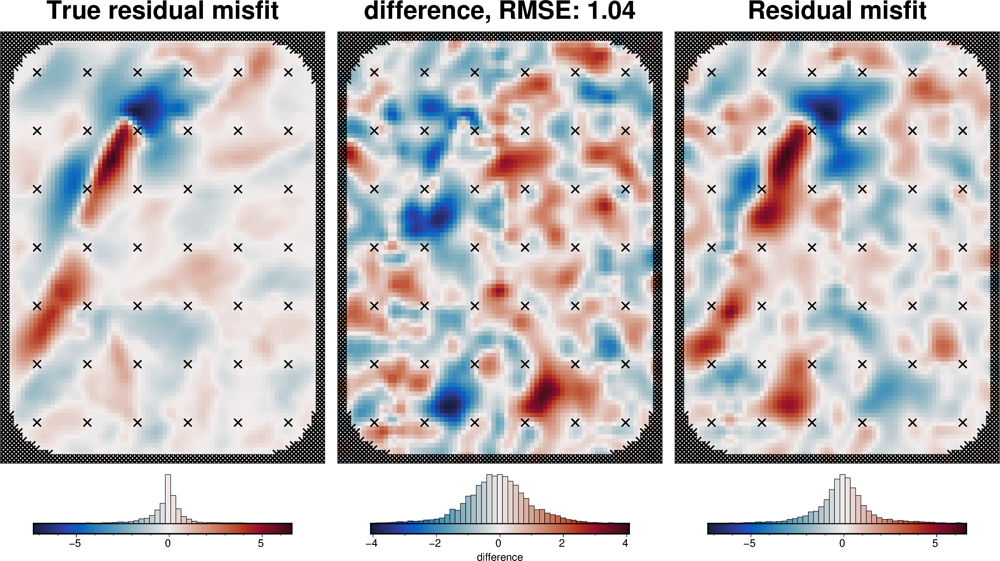

In [49]:
density_grid = xr.where(
    starting_bathymetry >= zref,
    true_density_contrast,
    -true_density_contrast,
)
# create layer of prisms
starting_prisms_true = utils.grids_to_prisms(
    starting_bathymetry,
    zref,
    density=density_grid,
)

grav_df_true_density = grav_df.copy()

grav_df_true_density["starting_gravity"] = starting_prisms_true.prism_layer.gravity(
    coordinates=(
        grav_df_true_density.easting,
        grav_df_true_density.northing,
        grav_df_true_density.upward,
    ),
    field="g_z",
    progressbar=True,
)

# temporarily set some kwargs
true_density_reg_kwargs = copy.deepcopy(regional_grav_kwargs)
true_density_reg_kwargs["cv_kwargs"]["fname"] = (
    "../tmp_outputs/Ross_Sea_05_regional_sep_true_density"
)
true_density_reg_kwargs["cv_kwargs"]["progressbar"] = True

grav_df_true_density = regional.regional_separation(
    grav_df=grav_df_true_density,
    **true_density_reg_kwargs,
)

regional_comparison(grav_df_true_density)

In [50]:
# re-load the study from the saved pickle file
with pathlib.Path(
    f"{true_density_reg_kwargs.get('cv_kwargs').get('fname')}.pickle"
).open("rb") as f:
    study = pickle.load(f)
reg_eq_depth = min(study.best_trials, key=lambda t: t.values[0]).params["depth"]
# reg_eq_damping = min(study.best_trials, key=lambda t: t.values[0]).params["damping"]
reg_eq_damping = None

new_true_density_reg_kwargs = dict(
    method="constraints",
    grid_method="eq_sources",
    constraints_df=constraint_points,
    damping=reg_eq_damping,
    depth=reg_eq_depth,
    block_size=None,
)
reg_eq_depth, reg_eq_damping

(209538.1557526367, None)

In [51]:
grav_df_true_density

,northing,easting,upward,bathymetry_grav,basement_grav_normalized,basement_grav,gravity_anomaly_full_res_no_noise,gravity_anomaly_full_res,uncert,eqs_gravity_anomaly,gravity_anomaly,starting_gravity,true_res,misfit,reg,res
0,-1600000.0,-40000.0,1000.0,-35.551085,-0.575645,-36.300394,-71.851479,-72.911198,3,-64.481389,-64.481389,-35.578561,-3.009718,-28.902828,-29.703803,0.800975
1,-1600000.0,-38000.0,1000.0,-36.054683,-0.523223,-33.941405,-69.996088,-72.483909,3,-64.163085,-64.163085,-36.042642,-3.088852,-28.120443,-28.604230,0.483787
2,-1600000.0,-36000.0,1000.0,-36.473168,-0.466365,-31.382798,-67.855967,-68.870245,3,-63.178870,-63.178870,-36.460095,-3.125521,-26.718775,-27.043396,0.324621
3,-1600000.0,-34000.0,1000.0,-36.755627,-0.406022,-28.667352,-65.422980,-61.536475,3,-61.636021,-61.636021,-36.784649,-3.111132,-24.851373,-25.131155,0.279782
4,-1600000.0,-32000.0,1000.0,-36.951045,-0.343163,-25.838709,-62.789754,-65.528788,3,-59.623519,-59.623519,-36.998469,-3.110982,-22.625050,-22.965604,0.340554
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7671,-1400000.0,102000.0,1000.0,-25.760090,0.399167,7.566127,-18.193963,-19.271274,3,-15.904465,-15.904465,-25.498180,-2.438584,9.593715,9.315947,0.277767
7672,-1400000.0,104000.0,1000.0,-25.911429,0.334798,4.669511,-21.241918,-24.226858,3,-18.079420,-18.079420,-25.673780,-2.429314,7.594360,7.339385,0.254975
7673,-1400000.0,106000.0,1000.0,-26.032814,0.268741,1.696963,-24.335851,-19.966292,3,-20.010773,-20.010773,-25.808792,-2.427211,5.798019,5.556914,0.241104
7674,-1400000.0,108000.0,1000.0,-26.121903,0.201716,-1.319170,-27.441073,-21.510609,3,-21.483911,-21.483911,-25.904533,-2.428732,4.420623,4.103737,0.316886


INFO:invert4geom:Sampled 'depth' parameter values; mean: 209538.15575263673, min: 106866.3460871086, max: 312209.96541816485


starting regional ensemble:   0%|          | 0/20 [00:00<?, ?it/s]

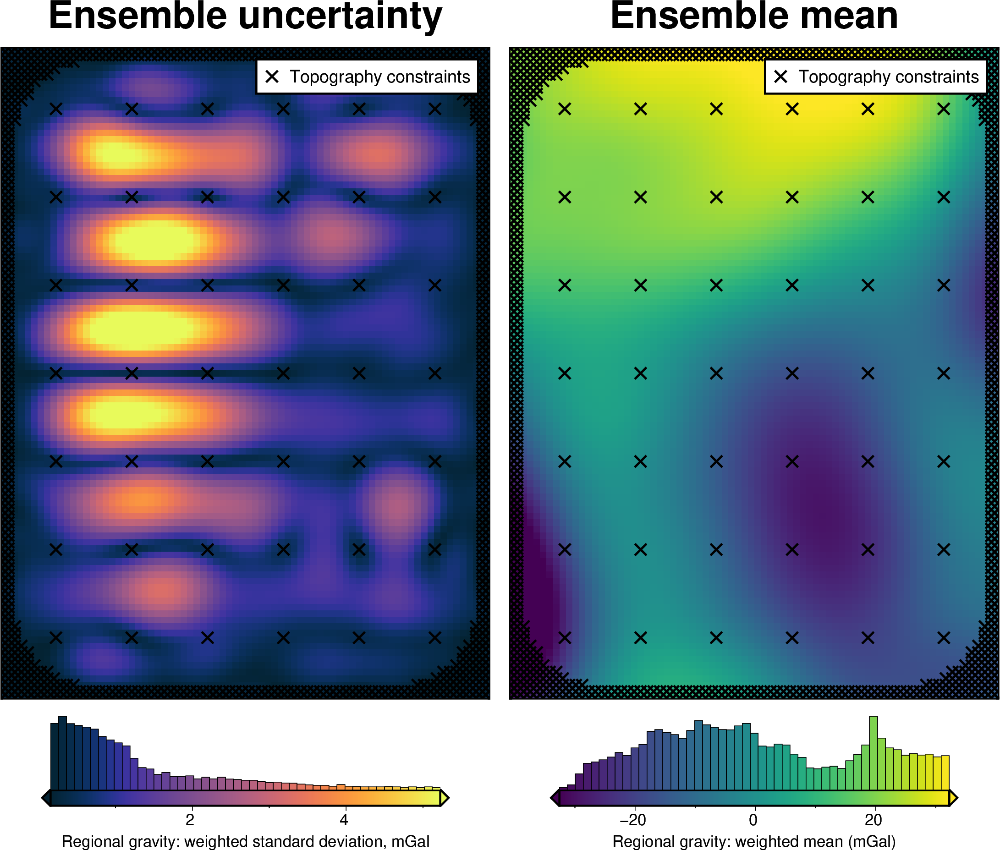

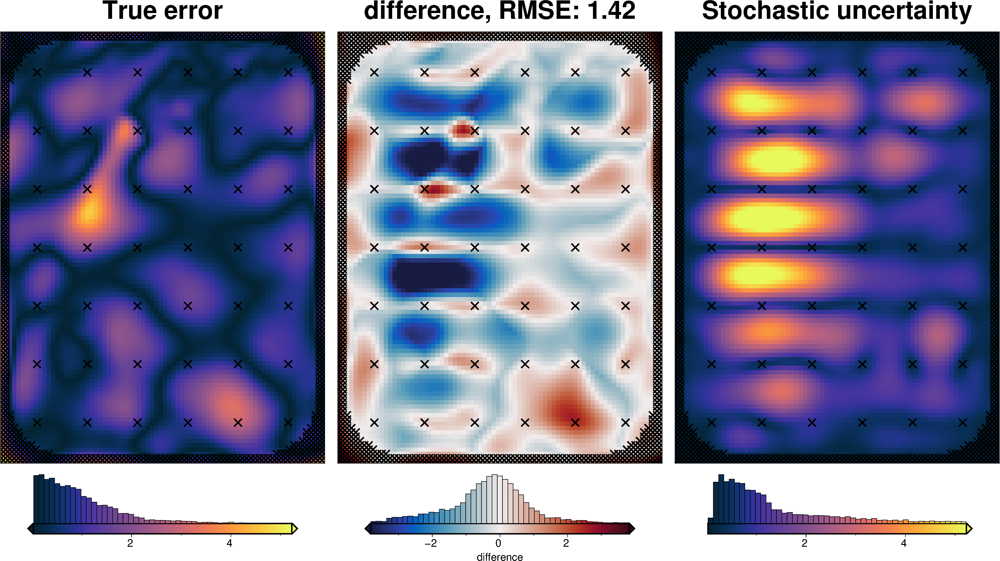

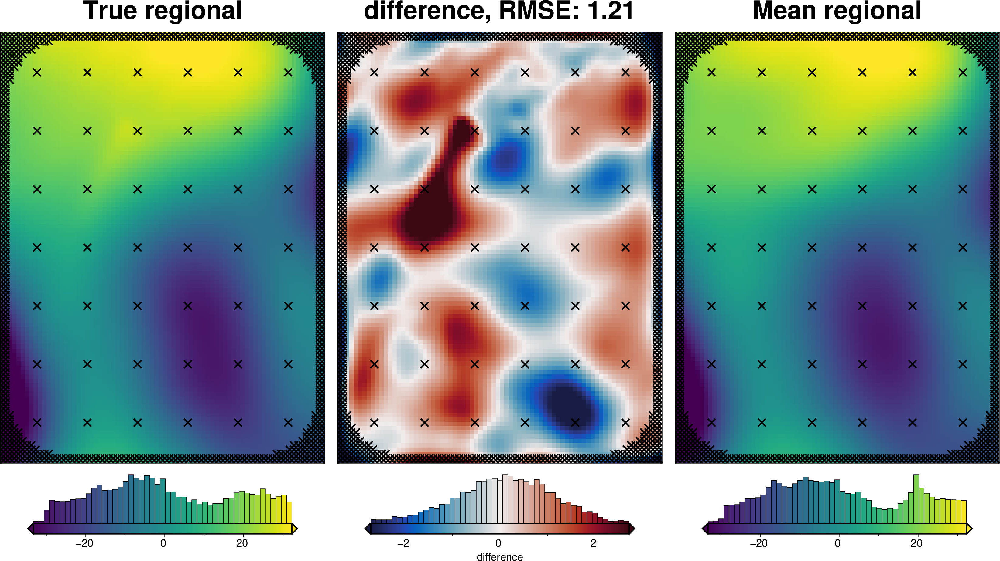

In [52]:
regional_misfit_parameter_dict = {
    "depth": {
        "distribution": "normal",
        "loc": reg_eq_depth,  # mean
        "scale": reg_eq_depth / 4,  # standard deviation
    },
    # "damping": {
    #     "distribution": "normal",
    #     "loc": np.log10(reg_eq_damping),  # mean base 10 exponent
    #     "scale": 2, #np.abs(np.log10(reg_eq_damping))/4,  # standard deviation of exponent
    #     "log": True,
    # },
}

regional_misfit_stats, _ = uncertainty.regional_misfit_uncertainty(
    runs=20,
    parameter_dict=regional_misfit_parameter_dict,
    plot_region=inversion_region,
    true_regional=grav_df_true_density.set_index(["northing", "easting"])
    .to_xarray()
    .basement_grav,
    weight_by="constraints",
    # weight_by=None,
    grav_df=grav_df_true_density,
    **new_true_density_reg_kwargs,
)

In [53]:
regional_misfit_stats

<xarray.Dataset> Size: 2MB
Dimensions:         (northing: 101, easting: 76, runs: 20)
Coordinates:
  * northing        (northing) float64 808B -1.6e+06 -1.598e+06 ... -1.4e+06
  * easting         (easting) float64 608B -4e+04 -3.8e+04 ... 1.08e+05 1.1e+05
  * runs            (runs) <U6 480B 'run_0' 'run_1' ... 'run_18' 'run_19'
Data variables:
    run_num         (runs, northing, easting) float64 1MB -29.33 ... 2.249
    z_mean          (northing, easting) float64 61kB -29.32 -28.24 ... 3.258
    z_stdev         (northing, easting) float64 61kB 0.3143 0.2288 ... 0.5697
    weighted_mean   (northing, easting) float64 61kB -29.32 -28.24 ... 3.258
    weighted_stdev  (northing, easting) float64 61kB 0.3143 0.2288 ... 0.5697
    z_min           (northing, easting) float64 61kB -29.86 -28.59 ... 2.105
    z_max           (northing, easting) float64 61kB -28.69 -27.82 ... 4.165

In [54]:
grav_grid = grav_df_true_density.set_index(["northing", "easting"]).to_xarray()
grav_grid["reg_uncert"] = regional_misfit_stats.z_stdev
grav_df_true_density = vd.grid_to_table(grav_grid)
grav_df_true_density

,northing,easting,upward,bathymetry_grav,basement_grav_normalized,basement_grav,gravity_anomaly_full_res_no_noise,gravity_anomaly_full_res,uncert,eqs_gravity_anomaly,gravity_anomaly,starting_gravity,true_res,misfit,reg,res,reg_uncert
0,-1600000.0,-40000.0,1000.0,-35.551085,-0.575645,-36.300394,-71.851479,-72.911198,3,-64.481389,-64.481389,-35.578561,-3.009718,-28.902828,-29.703803,0.800975,0.314340
1,-1600000.0,-38000.0,1000.0,-36.054683,-0.523223,-33.941405,-69.996088,-72.483909,3,-64.163085,-64.163085,-36.042642,-3.088852,-28.120443,-28.604230,0.483787,0.228791
2,-1600000.0,-36000.0,1000.0,-36.473168,-0.466365,-31.382798,-67.855967,-68.870245,3,-63.178870,-63.178870,-36.460095,-3.125521,-26.718775,-27.043396,0.324621,0.287664
3,-1600000.0,-34000.0,1000.0,-36.755627,-0.406022,-28.667352,-65.422980,-61.536475,3,-61.636021,-61.636021,-36.784649,-3.111132,-24.851373,-25.131155,0.279782,0.298222
4,-1600000.0,-32000.0,1000.0,-36.951045,-0.343163,-25.838709,-62.789754,-65.528788,3,-59.623519,-59.623519,-36.998469,-3.110982,-22.625050,-22.965604,0.340554,0.269666
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7671,-1400000.0,102000.0,1000.0,-25.760090,0.399167,7.566127,-18.193963,-19.271274,3,-15.904465,-15.904465,-25.498180,-2.438584,9.593715,9.315947,0.277767,0.144623
7672,-1400000.0,104000.0,1000.0,-25.911429,0.334798,4.669511,-21.241918,-24.226858,3,-18.079420,-18.079420,-25.673780,-2.429314,7.594360,7.339385,0.254975,0.170428
7673,-1400000.0,106000.0,1000.0,-26.032814,0.268741,1.696963,-24.335851,-19.966292,3,-20.010773,-20.010773,-25.808792,-2.427211,5.798019,5.556914,0.241104,0.176473
7674,-1400000.0,108000.0,1000.0,-26.121903,0.201716,-1.319170,-27.441073,-21.510609,3,-21.483911,-21.483911,-25.904533,-2.428732,4.420623,4.103737,0.316886,0.240181


In [55]:
grav_df_true_density.to_csv(f"{fpath}_grav_df_true_density.csv", index=False)

# Uncertainty analysis

## Inversion error

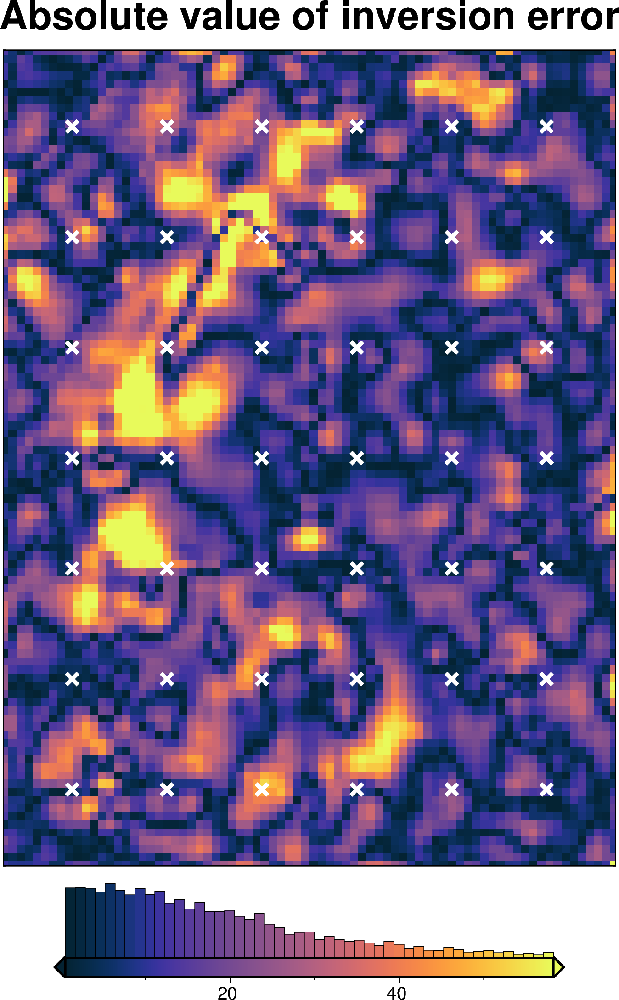

In [56]:
inversion_error = np.abs(bathymetry - final_topography)

fig = maps.plot_grd(
    inversion_error,
    region=inversion_region,
    # region=vd.pad_region(inversion_region, -3*spacing),
    hist=True,
    cmap="thermal",
    title="Absolute value of inversion error",
    robust=True,
    points=constraint_points[constraint_points.inside],
    points_style="x.3c",
    points_fill="white",
    points_pen="2p",
)
fig.show()

In [57]:
# re-load the study from the saved pickle file
with pathlib.Path(f"{regional_grav_kwargs.get('cv_kwargs').get('fname')}.pickle").open(
    "rb"
) as f:
    study = pickle.load(f)
reg_eq_depth = min(study.best_trials, key=lambda t: t.values[0]).params["depth"]
reg_eq_damping = None

new_regional_grav_kwargs = dict(
    method="constraints",
    grid_method="eq_sources",
    constraints_df=constraint_points,
    damping=reg_eq_damping,
    depth=reg_eq_depth,
    block_size=None,
)
reg_eq_depth, reg_eq_damping

(272567.6395660266, None)

In [58]:
# kwargs to reuse for all uncertainty analyses
uncert_kwargs = dict(
    grav_df=grav_df,
    density_contrast=best_density_contrast,
    zref=zref,
    starting_prisms=starting_prisms,
    starting_topography=starting_bathymetry,
    regional_grav_kwargs=new_regional_grav_kwargs,
    **kwargs,
)

## Solver damping component

In [59]:
# load study
with pathlib.Path(f"{fpath}_damping_cv_damping_cv_study.pickle").open("rb") as f:
    study = pickle.load(f)

study_df = study.trials_dataframe().drop(columns=["user_attrs_results"])
study_df = study_df.sort_values("value")

# calculate zscores of values
study_df["value_zscore"] = sp.stats.zscore(study_df["value"])

# drop outliers (values with zscore > |2|)
study_df2 = study_df[(np.abs(study_df.value_zscore) < 2)]

# pick damping standard deviation based on optimization
# to have a normal distribution a log scale, use the stdev of the log of the values
stdev = np.log10(study_df2.params_damping).std()

print(f"calculated stdev: {stdev}")
stdev = stdev / 2
print(f"using stdev: {stdev}")

calculated stdev: 0.4754389855399992
using stdev: 0.2377194927699996


best: 0.013422423312811651 
std: 0.2377194927699996 
+1std: 0.023203335742324034 
-1std: 0.007764463247397928


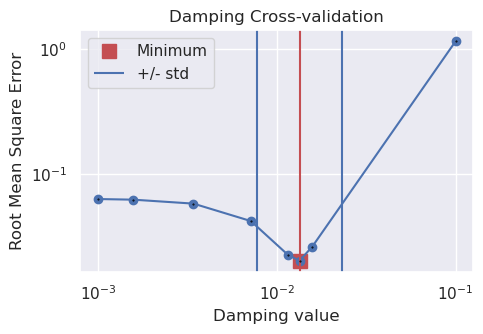

In [60]:
fig = plotting.plot_cv_scores(
    study_df.value,
    study_df.params_damping,
    param_name="Damping",
    logx=True,
    logy=True,
)
ax = fig.axes[0]

y_lims = ax.get_ylim()

# plot the best value
best = float(study_df2.params_damping.iloc[0])
ax.vlines(best, ymin=y_lims[0], ymax=y_lims[1], color="r")

# for a log scale, use the log of the best value, stdev already in log scale
upper = float(10 ** (np.log10(best) + stdev))
lower = float(10 ** (np.log10(best) - stdev))
ax.vlines(upper, ymin=y_lims[0], ymax=y_lims[1], label="+/- std")
ax.vlines(lower, ymin=y_lims[0], ymax=y_lims[1])

x_lims = ax.get_xlim()
ax.set_xlim(
    min(x_lims[0], lower),
    max(x_lims[1], upper),
)
ax.legend()
print("best:", best, "\nstd:", stdev, "\n+1std:", upper, "\n-1std:", lower)

INFO:invert4geom:Sampled 'solver_damping' parameter values; mean: 0.015281008019680586, min: 0.005455281447082818, max: 0.03302514257713503
INFO:invert4geom:No pickle files starting with '../results/Ross_Sea/Ross_Sea_05_uncertainty_damping' found, creating new files



stochastic ensemble:   0%|          | 0/10 [00:00<?, ?it/s]

INFO:invert4geom:starting stochastic uncertainty analysis at run 0 of 10
saving results to pickle files with prefix: '../results/Ross_Sea/Ross_Sea_05_uncertainty_damping'



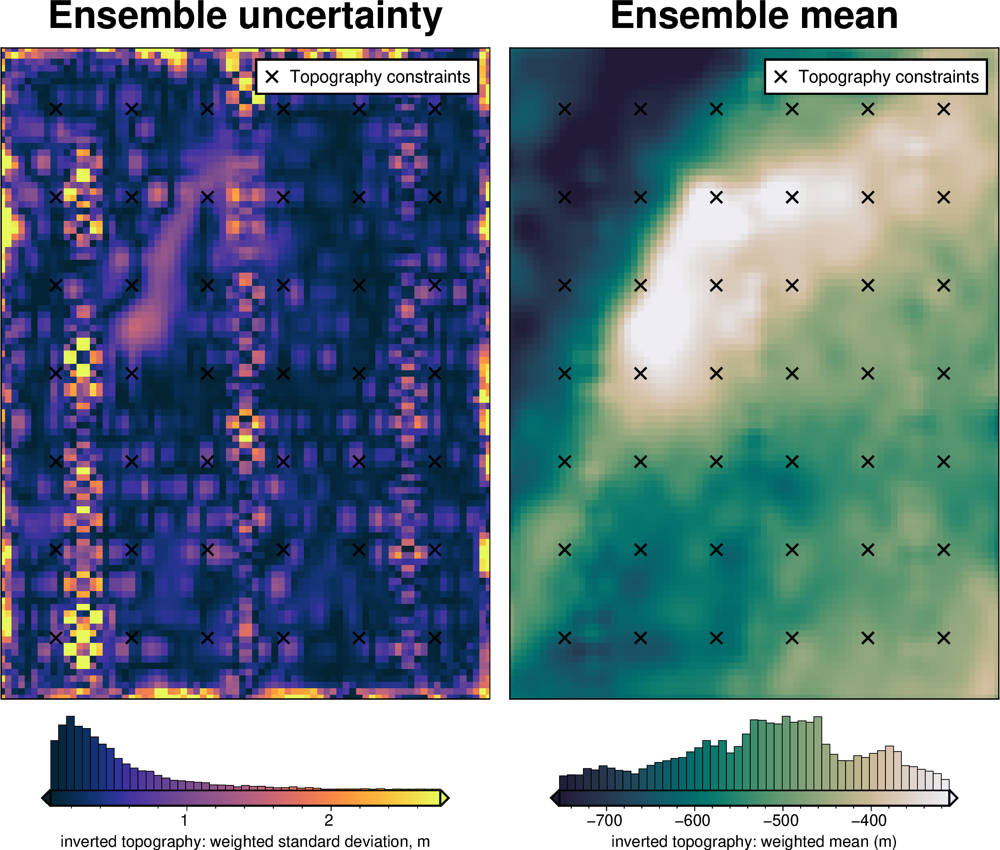

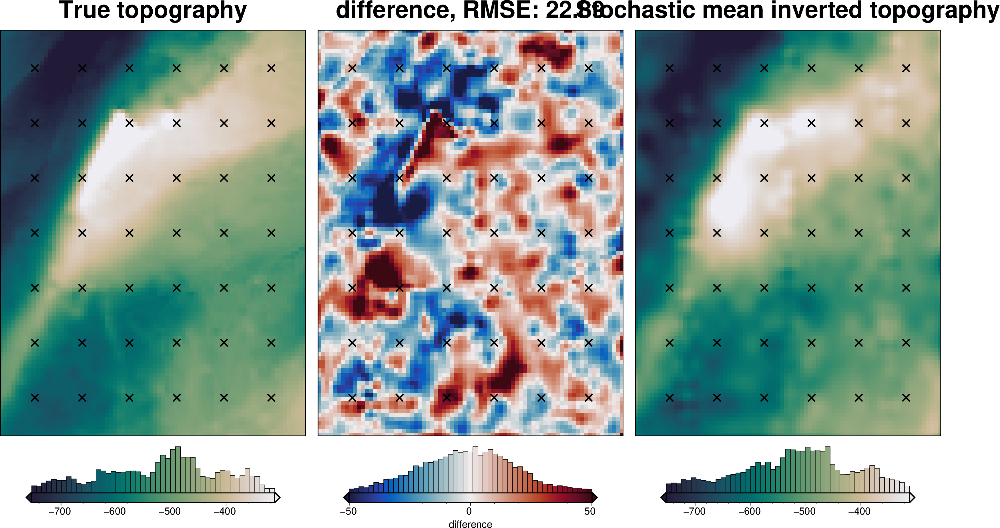

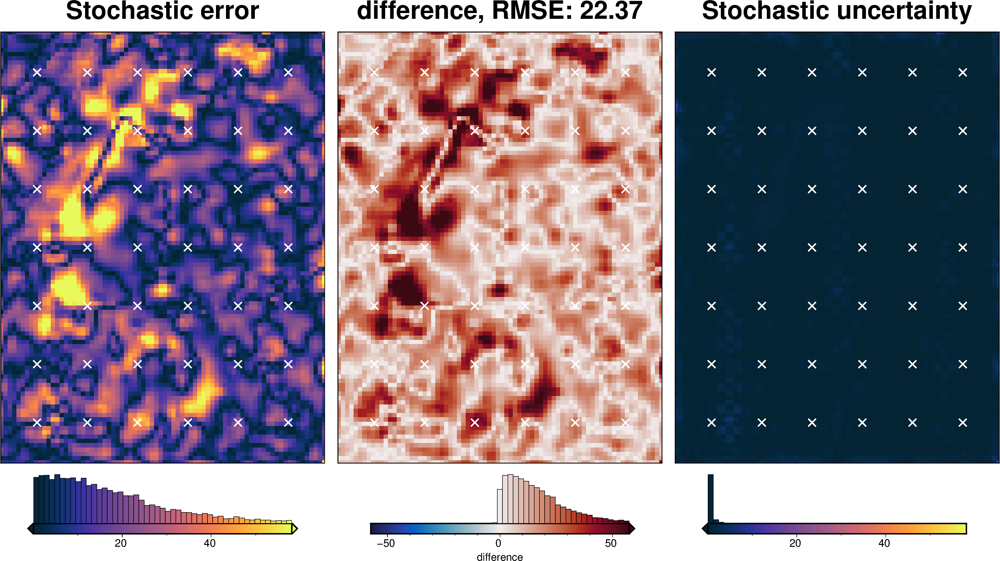

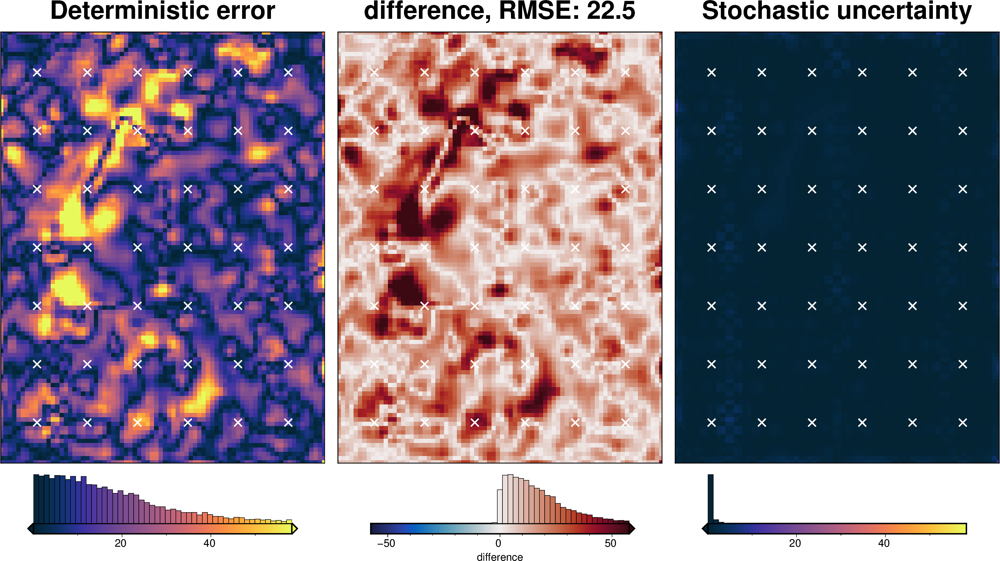

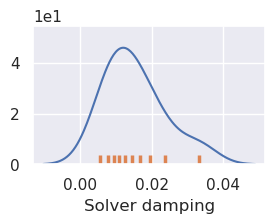

In [61]:
solver_dict = {
    "solver_damping": {
        "distribution": "normal",
        "loc": np.log10(
            best_damping
        ),  # mean of base 10 exponent, supply log10(value) here
        "scale": stdev,  # stdev of base 10 exponent, already in log10 form
        "log": True,
    },
}
fname = f"{fpath}_uncertainty_damping"

# delete files if already exist
for p in pathlib.Path().glob(f"{fname}*"):
    p.unlink(missing_ok=True)

uncert_damping_results = uncertainty.full_workflow_uncertainty_loop(
    fname=fname,
    runs=10,
    parameter_dict=solver_dict,
    **uncert_kwargs,
)

stats_ds = synth_plotting.uncert_plots(
    uncert_damping_results,
    inversion_region,
    bathymetry,
    deterministic_bathymetry=final_topography,
    constraint_points=constraint_points[constraint_points.inside],
    weight_by="constraints",
    # weight_by="residual",
    # weight_by=None,
)

plotting.plot_latin_hypercube(
    uncert_damping_results[-1],
)

## Density component

In [62]:
# load study
with pathlib.Path(f"{fpath}_density_cv_kfolds_study.pickle").open("rb") as f:
    study = pickle.load(f)

study_df = study.trials_dataframe()
study_df = study_df.sort_values("value")

# calculate zscores of values
study_df["value_zscore"] = sp.stats.zscore(study_df["value"])

# drop outliers (values with zscore > |2|)
study_df2 = study_df[(np.abs(study_df.value_zscore) < 2)]

stdev = study_df2.params_density_contrast.std()
print(f"calculated stdev: {stdev}")

# manually pick a stdev
stdev = 500
print(f"using stdev: {stdev}")

print(
    f"density estimation error: {np.abs(true_density_contrast - best_density_contrast)}"
)

calculated stdev: 226.3079559120512
using stdev: 500
density estimation error: 549


best: 2025 
std: 500 
+1std: 2525 
-1std: 1525


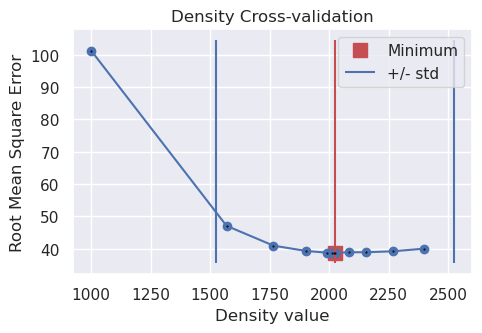

In [63]:
fig = plotting.plot_cv_scores(
    study.trials_dataframe().value.values,
    study.trials_dataframe().params_density_contrast.values,
    param_name="Density",
    logx=False,
    logy=False,
)
ax = fig.axes[0]

best = study_df2.params_density_contrast.iloc[0]
upper = best + stdev
lower = best - stdev

y_lims = ax.get_ylim()
ax.vlines(best, ymin=y_lims[0], ymax=y_lims[1], color="r")
ax.vlines(upper, ymin=y_lims[0], ymax=y_lims[1], label="+/- std")
ax.vlines(lower, ymin=y_lims[0], ymax=y_lims[1])

x_lims = ax.get_xlim()
ax.set_xlim(
    min(x_lims[0], lower),
    max(x_lims[1], upper),
)
ax.legend()
print("best:", best, "\nstd:", stdev, "\n+1std:", upper, "\n-1std:", lower)

INFO:invert4geom:Sampled 'density_contrast' parameter values; mean: 2025.0, min: 1202.5731865242635, max: 2847.4268134757363
INFO:invert4geom:No pickle files starting with '../results/Ross_Sea/Ross_Sea_05_uncertainty_density' found, creating new files



stochastic ensemble:   0%|          | 0/10 [00:00<?, ?it/s]

INFO:invert4geom:starting stochastic uncertainty analysis at run 0 of 10
saving results to pickle files with prefix: '../results/Ross_Sea/Ross_Sea_05_uncertainty_density'



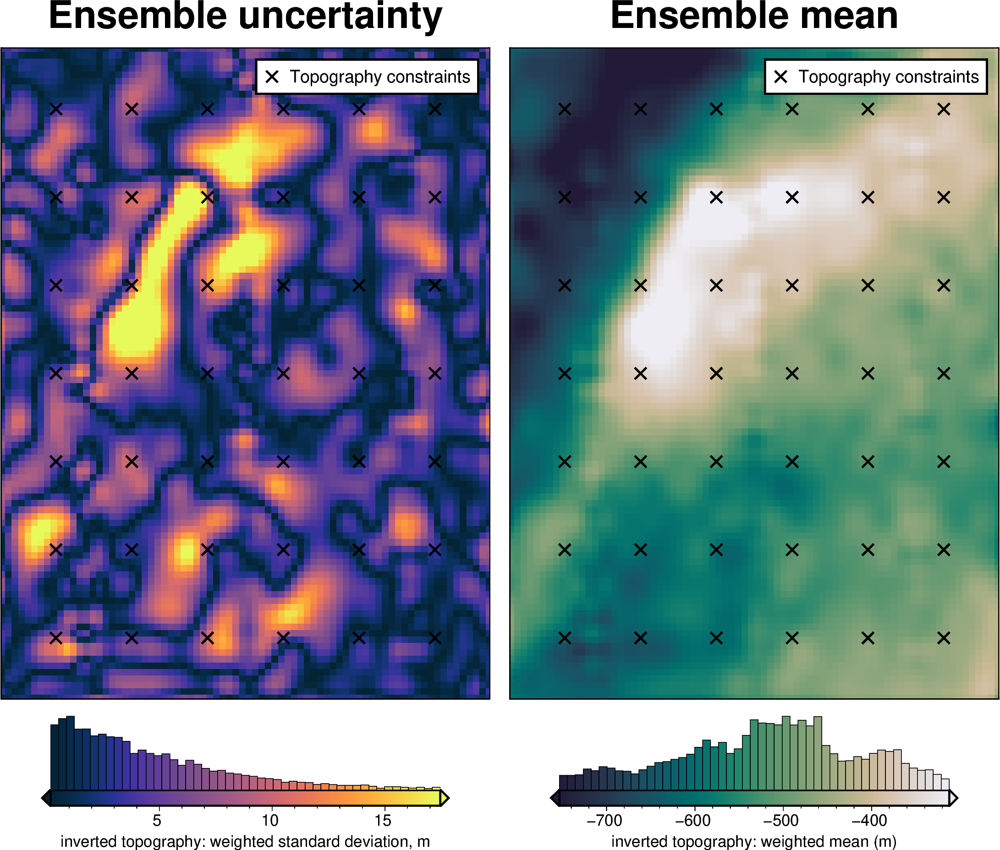

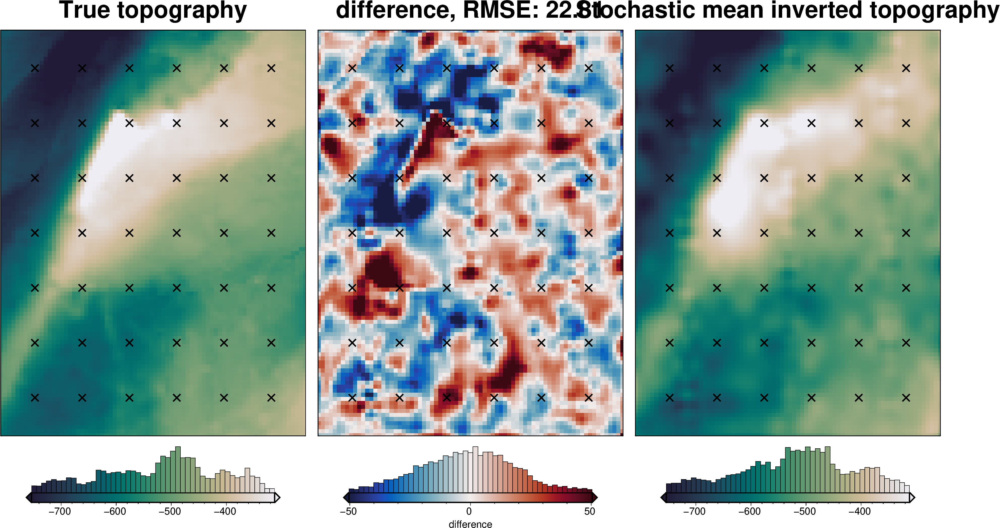

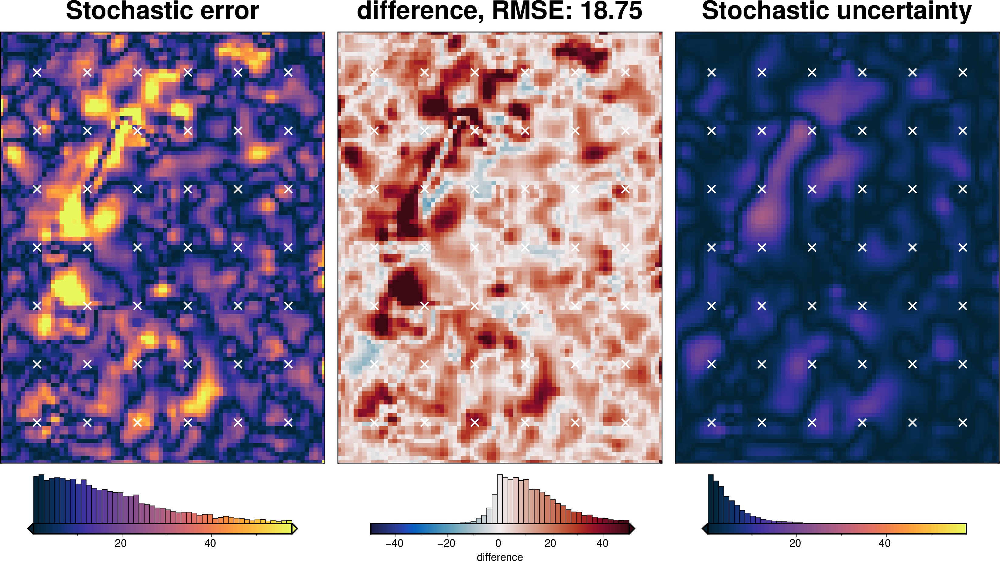

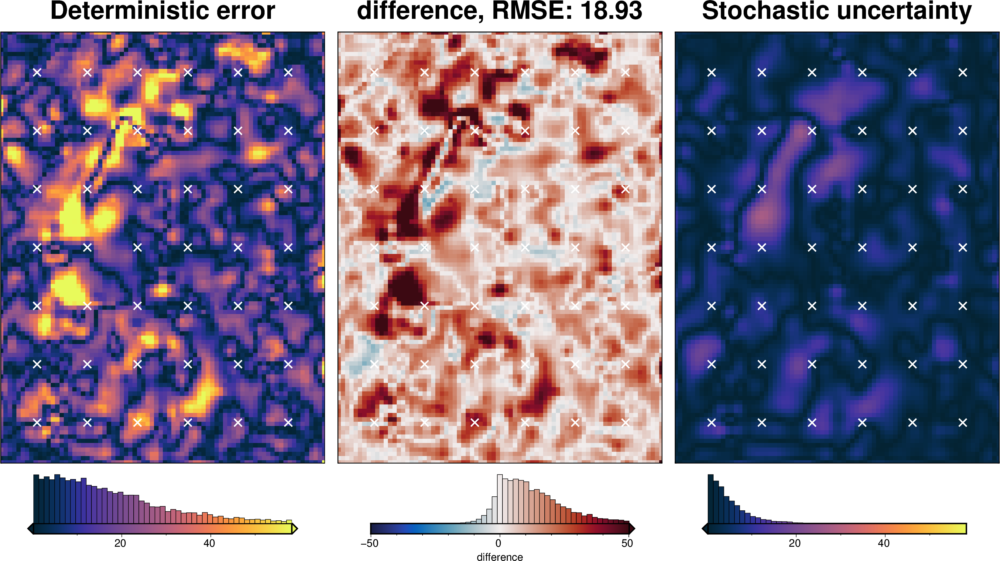

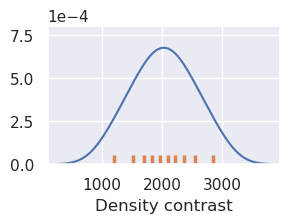

In [64]:
density_dict = {
    "density_contrast": {
        "distribution": "normal",
        "loc": best_density_contrast,
        "scale": stdev,
    },
}
fname = f"{fpath}_uncertainty_density"

# delete files if already exist
for p in pathlib.Path().glob(f"{fname}*"):
    p.unlink(missing_ok=True)

uncert_density_results = uncertainty.full_workflow_uncertainty_loop(
    fname=fname,
    runs=10,
    parameter_dict=density_dict,
    **uncert_kwargs,
)

stats_ds = synth_plotting.uncert_plots(
    uncert_density_results,
    inversion_region,
    bathymetry,
    deterministic_bathymetry=final_topography,
    constraint_points=constraint_points[constraint_points.inside],
    weight_by="constraints",
    # weight_by="residual",
    # weight_by=None,
)

plotting.plot_latin_hypercube(
    uncert_density_results[-1],
)

## Constraints component

In [65]:
# # set uncertainty as 5% of each points depth
# uncert = np.abs(0.05 * constraint_points.upward)
# constraint_points.loc[constraint_points.index, "uncert"] = uncert
# constraint_points

In [66]:
# fname = f"{fpath}_uncertainty_constraints"

# # delete files if already exist
# for p in pathlib.Path().glob(f"{fname}*"):
#     p.unlink(missing_ok=True)

# uncert_constraints_results = uncertainty.full_workflow_uncertainty_loop(
#     fname=fname,
#     sample_constraints=True,
#     constraints_df=constraint_points,
#     starting_topography_kwargs=starting_topography_kwargs,
#     runs=10,
#     **uncert_kwargs,
# )

# stats_ds = synth_plotting.uncert_plots(
#     uncert_constraints_results,
#     inversion_region,
#     bathymetry,
#     deterministic_bathymetry=final_topography,
#     constraint_points=constraint_points[constraint_points.inside],
#     weight_by="constraints",
#     # weight_by="residual",
#     # weight_by=None,
# )

## Gravity component

INFO:invert4geom:No pickle files starting with '../results/Ross_Sea/Ross_Sea_05_uncertainty_grav_filter' found, creating new files



stochastic ensemble:   0%|          | 0/10 [00:00<?, ?it/s]

INFO:invert4geom:starting stochastic uncertainty analysis at run 0 of 10
saving results to pickle files with prefix: '../results/Ross_Sea/Ross_Sea_05_uncertainty_grav_filter'



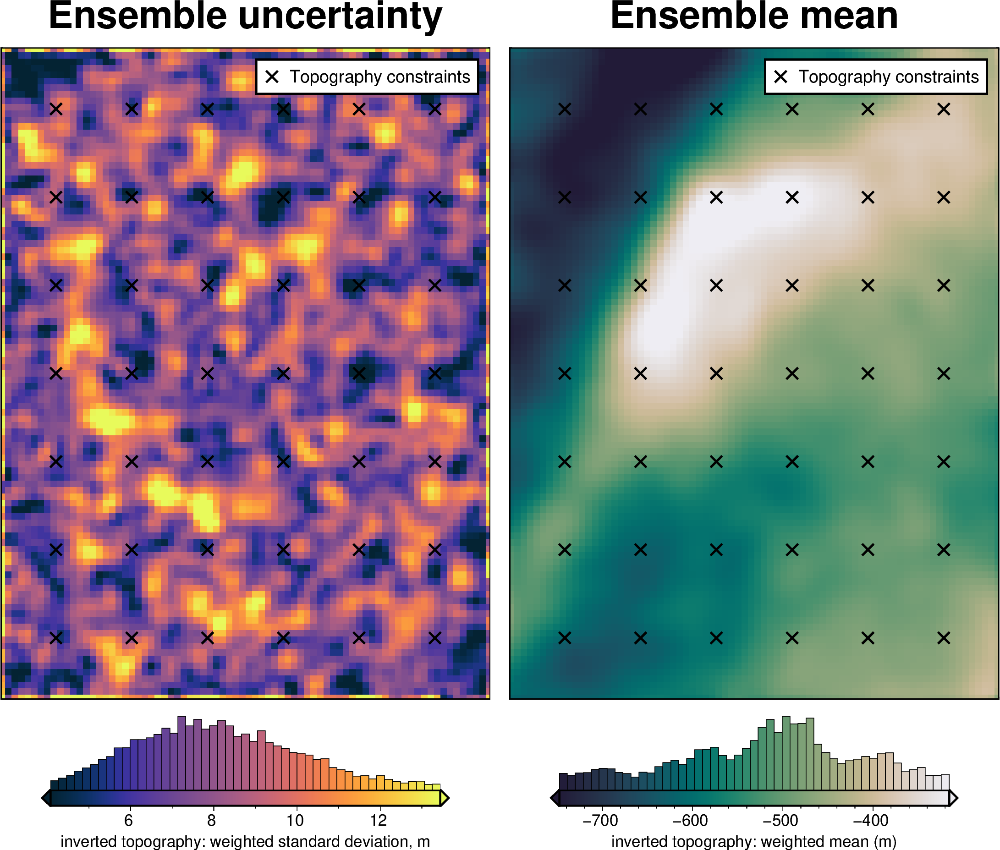

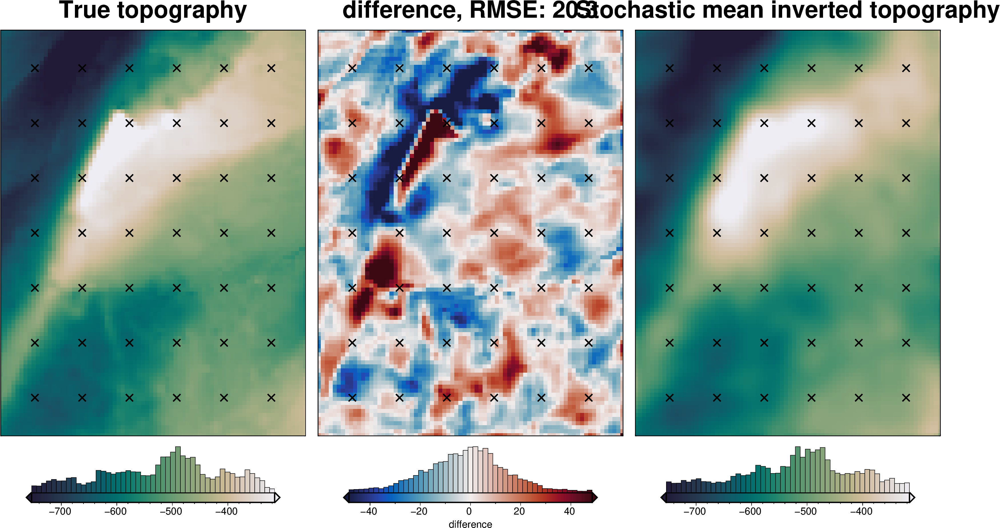

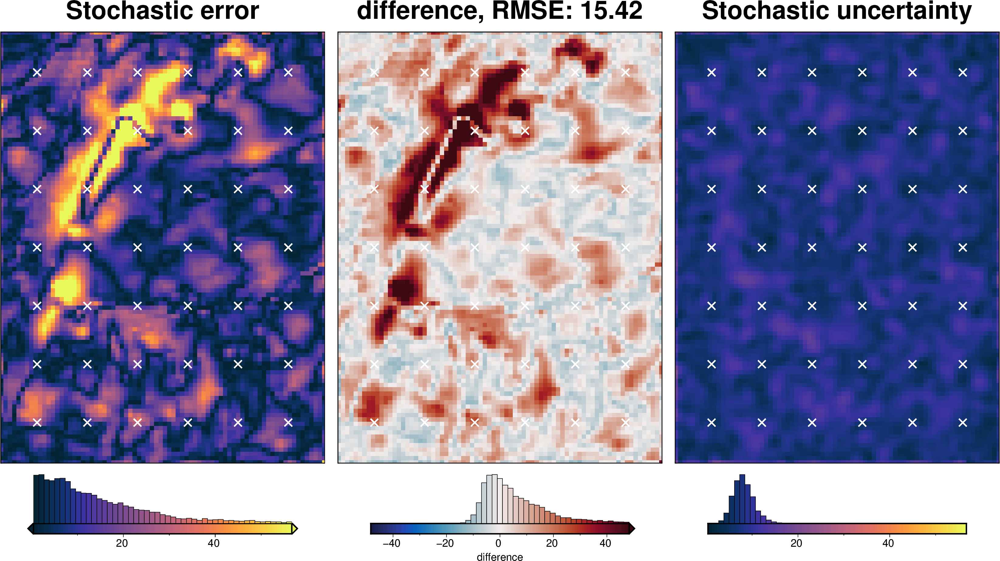

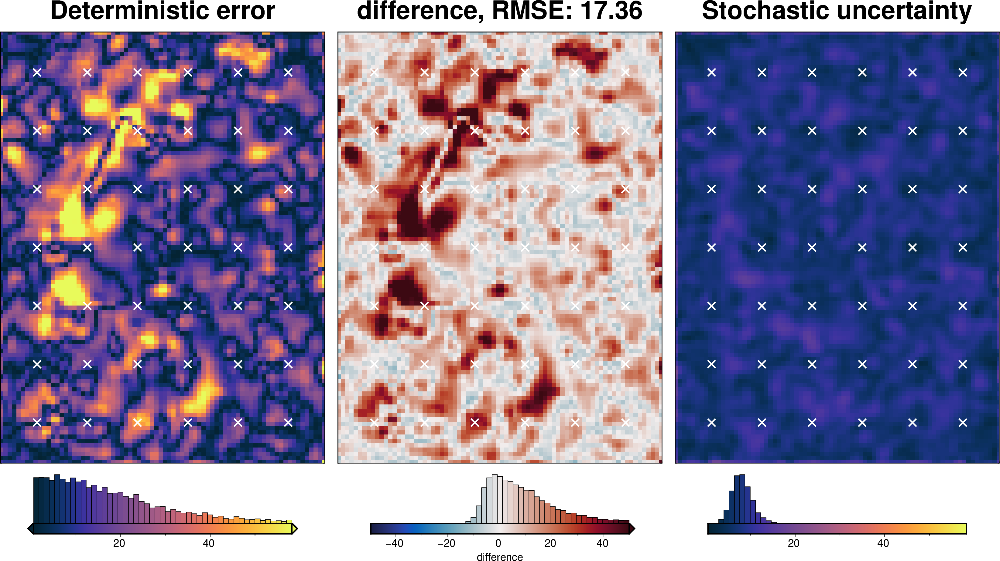

In [67]:
fname = f"{fpath}_uncertainty_grav_filter"

# delete files if already exist
for p in pathlib.Path().glob(f"{fname}*"):
    p.unlink(missing_ok=True)

uncert_grav_results = uncertainty.full_workflow_uncertainty_loop(
    fname=fname,
    runs=10,
    sample_gravity=True,
    gravity_filter_width=filt_width,
    **uncert_kwargs,
)

stats_ds = synth_plotting.uncert_plots(
    uncert_grav_results,
    inversion_region,
    bathymetry,
    deterministic_bathymetry=final_topography,
    constraint_points=constraint_points[constraint_points.inside],
    weight_by="constraints",
    # weight_by="residual",
    # weight_by=None,
)

## Regional gravity component

In [68]:
# reg_eq_depth

In [69]:
# regional_misfit_parameter_dict = {
#     "depth": {
#         "distribution": "normal",
#         "loc": reg_eq_depth,  # mean
#         "scale": reg_eq_depth / 4,  # standard deviation
#     },
#     # "damping": {
#     #     "distribution": "normal",
#     #     "loc": np.log10(reg_eq_damping),  # mean base 10 exponent
#     #     "scale": 2,  # np.abs(np.log10(reg_eq_damping)),  # standard deviation of exponent
#     #     "log": True,
#     # },
# }

# regional_misfit_stats = uncertainty.regional_misfit_uncertainty(
#     runs=20,
#     parameter_dict=regional_misfit_parameter_dict,
#     # plot_region=vd.pad_region(inversion_region, -3*spacing),
#     plot_region=inversion_region,
#     true_regional=grav_grid.basement_grav,
#     weight_by="constraints",
#     # weight_by="residual",
#     # weight_by=None,
#     grav_df=grav_df,
#     **new_regional_grav_kwargs,
# )

In [70]:
# grav_df = utils.sample_grids(
#     grav_df,
#     regional_misfit_stats.z_stdev,
#     sampled_name="reg_uncert",
#     coord_names=["easting", "northing"],
# )
# grav_df = utils.sample_grids(
#     grav_df,
#     regional_misfit_stats.z_mean,
#     sampled_name="reg_stochastic",
#     coord_names=["easting", "northing"],
# )
# grav_df

In [71]:
# # save to csv
# grav_df.to_csv(f"{fpath}_grav_df.csv", index=False)

In [72]:
# # update grav_df and temporarily rename column
# uncert_kwargs["grav_df"] = grav_df.drop(columns="reg").rename(
#     columns={
#         "reg_stochastic": "reg",
#     }
# )
# uncert_kwargs["grav_df"].reg

In [73]:
# fname = f"{fpath}_uncertainty_regional"

# # delete files if already exist
# for p in pathlib.Path().glob(f"{fname}*"):
#     p.unlink(missing_ok=True)

# uncert_regional_results = uncertainty.full_workflow_uncertainty_loop(
#     fname=fname,
#     runs=10,
#     regional_misfit_parameter_dict=regional_misfit_parameter_dict,
#     **uncert_kwargs,
# )

# stats_ds = synth_plotting.uncert_plots(
#     uncert_regional_results,
#     # vd.pad_region(inversion_region, -3*spacing),
#     inversion_region,
#     bathymetry,
#     deterministic_bathymetry=final_topography,
#     constraint_points=constraint_points[constraint_points.inside],
#     weight_by="constraints",
#     # weight_by="residual",
#     # weight_by=None,
# )

## Equivalent source gridding component

In [74]:
eqs.depth, eqs.damping

(10002.265810449084, 0.00018602392746886265)

INFO:invert4geom:Sampled 'depth' parameter values; mean: 10002.265810449082, min: 5889.200011436612, max: 14115.331609461555
INFO:invert4geom:Sampled 'damping' parameter values; mean: 0.03902034234896069, min: 9.546882014760588e-08, max: 0.3624733346179139


starting equivalent sources ensemble:   0%|          | 0/10 [00:00<?, ?it/s]

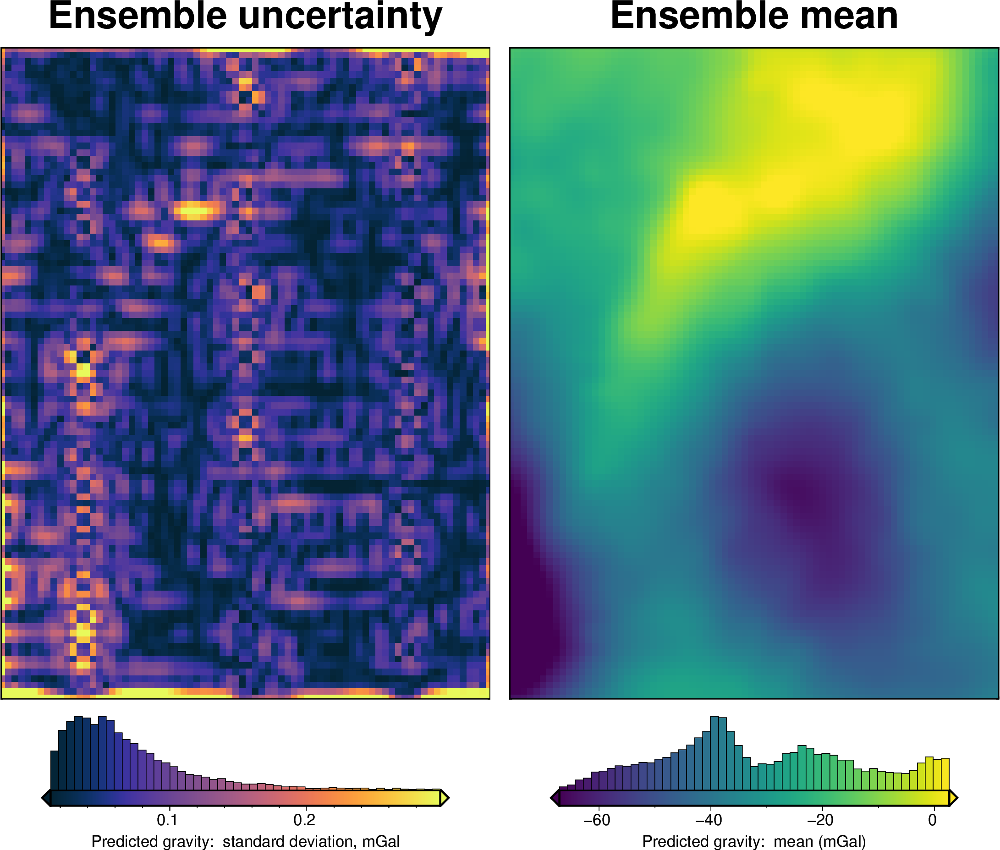

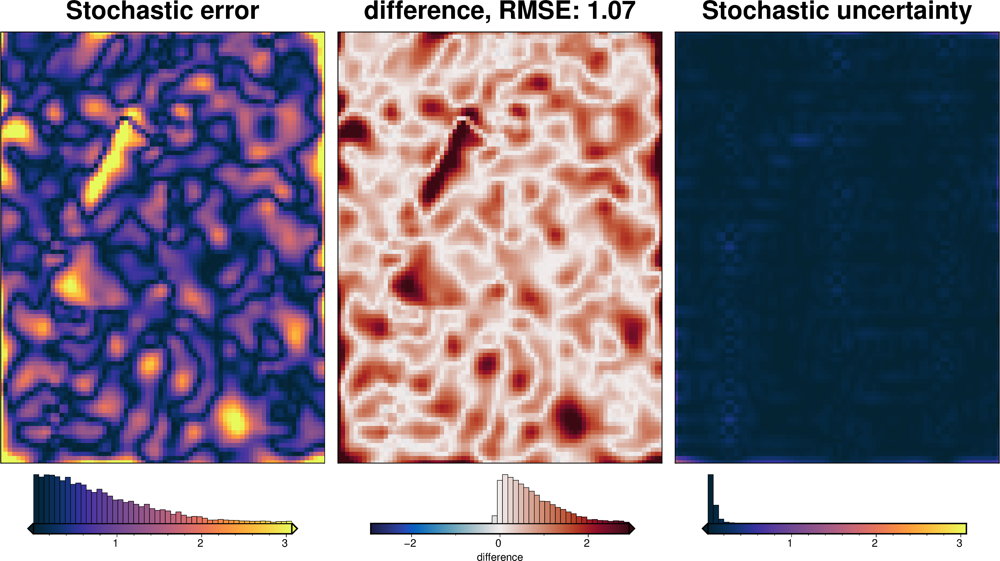

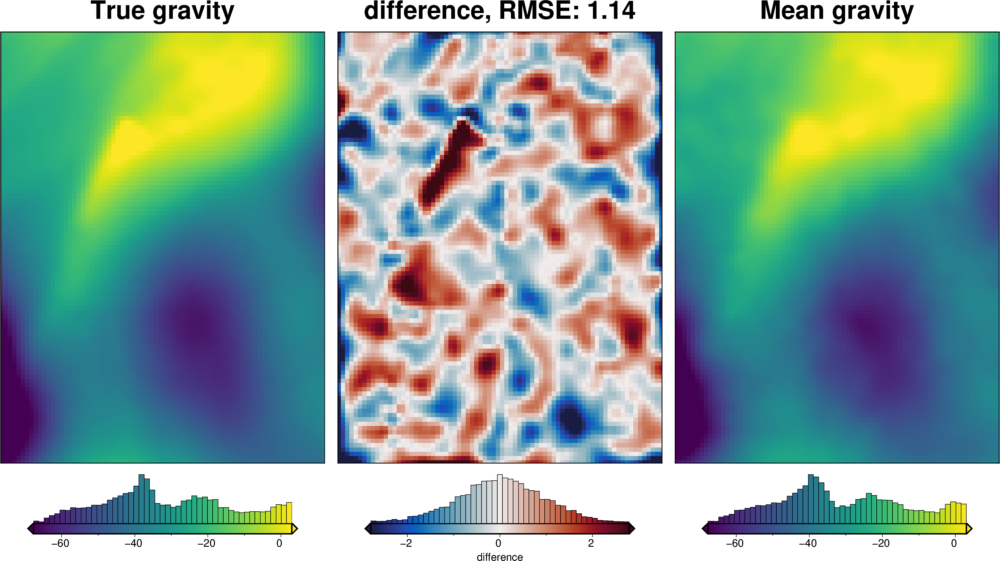

In [75]:
# grid the airborne survey data over the whole grid
coords = (grav_survey_df.easting, grav_survey_df.northing, grav_survey_df.upward)
data = grav_survey_df.gravity_anomaly

equivalent_source_parameter_dict = {
    "depth": {
        # "distribution": "uniform",
        # "loc": 2*min_dist,  # lower bound
        # "scale": 6*min_dist,  # range
        "distribution": "normal",
        "loc": eqs.depth,  # mean
        "scale": eqs.depth / 4,  # standard deviation
    },
    "damping": {
        # "distribution": "uniform",
        # "loc": -40,  # lower bound base 10 exponent
        # "scale": 40,  # range of exponent
        "log": True,
        "distribution": "normal",
        "loc": np.log10(
            eqs.damping
        ),  # mean of base 10 exponent, supply log10(value) here
        # "scale": np.abs(np.log10(eqs.damping))
        # * 5,  # stdev of base 10 exponent, supply log10(value) here
        "scale": 2,
    },
}

eqs_kwargs = dict(
    block_size=spacing,
    damping=eqs.damping,
    depth=eqs.depth,
)

eqs_stats, eqs_sampled_params = uncertainty.equivalent_sources_uncertainty(
    runs=10,
    data=data,
    coords=coords,
    grid_points=grav_df,
    parameter_dict=equivalent_source_parameter_dict,
    # plot_region=vd.pad_region(inversion_region, -3*spacing),
    plot_region=inversion_region,
    true_gravity=grav_df.set_index(["northing", "easting"])
    .to_xarray()
    .gravity_anomaly_full_res_no_noise,
    # weight_by="score",
    # weight_by="rmse",
    **eqs_kwargs,
)

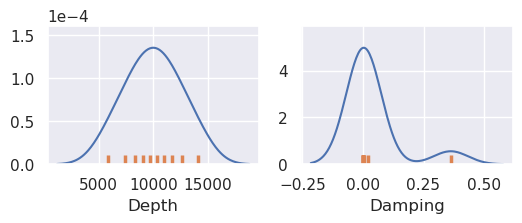

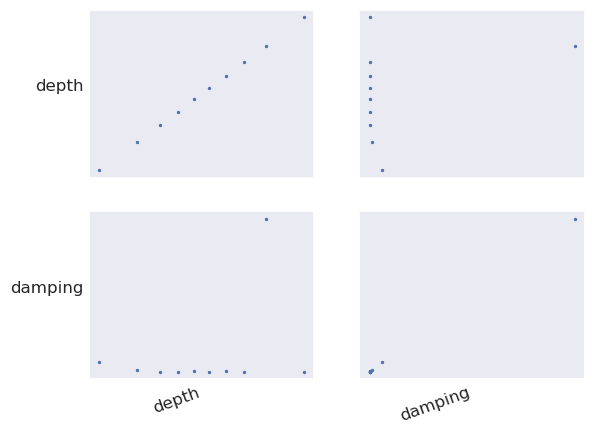

In [76]:
plotting.plot_latin_hypercube(
    eqs_sampled_params,
)

In [77]:
grav_df = utils.sample_grids(
    grav_df,
    eqs_stats.z_stdev,
    sampled_name="eqs_uncert",
    coord_names=["easting", "northing"],
)
grav_df = utils.sample_grids(
    grav_df,
    eqs_stats.z_mean,
    sampled_name="gravity_anomaly_eqs_mean",
    coord_names=["easting", "northing"],
)
grav_df

,northing,easting,upward,bathymetry_grav,basement_grav_normalized,basement_grav,gravity_anomaly_full_res_no_noise,gravity_anomaly_full_res,uncert,eqs_gravity_anomaly,gravity_anomaly,starting_gravity,true_res,misfit,reg,res,predicted_grav,eqs_uncert,gravity_anomaly_eqs_mean
0,-1600000.0,-40000.0,1000.0,-35.551085,-0.575645,-36.300394,-71.851479,-72.911198,3,-64.481389,-64.481389,-48.812051,-3.009718,-15.669338,-15.938882,0.269543,-63.548020,1.537731,-64.071709
1,-1600000.0,-38000.0,1000.0,-36.054683,-0.523223,-33.941405,-69.996088,-72.483909,3,-64.163085,-64.163085,-49.448746,-3.088852,-14.714339,-14.981851,0.267512,-63.265430,1.318696,-63.840919
2,-1600000.0,-36000.0,1000.0,-36.473168,-0.466365,-31.382798,-67.855967,-68.870245,3,-63.178870,-63.178870,-50.021472,-3.125521,-13.157398,-13.471448,0.314050,-62.373919,1.168135,-62.895153
3,-1600000.0,-34000.0,1000.0,-36.755627,-0.406022,-28.667352,-65.422980,-61.536475,3,-61.636021,-61.636021,-50.466743,-3.111132,-11.169278,-11.549389,0.380111,-60.927827,0.998435,-61.368729
4,-1600000.0,-32000.0,1000.0,-36.951045,-0.343163,-25.838709,-62.789754,-65.528788,3,-59.623519,-59.623519,-50.760094,-3.110982,-8.863425,-9.338096,0.474671,-59.029803,0.823200,-59.381863
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7671,-1400000.0,102000.0,1000.0,-25.760090,0.399167,7.566127,-18.193963,-19.271274,3,-15.904465,-15.904465,-34.982259,-2.438584,19.077794,19.148680,-0.070886,-15.257679,0.453508,-15.803412
7672,-1400000.0,104000.0,1000.0,-25.911429,0.334798,4.669511,-21.241918,-24.226858,3,-18.079420,-18.079420,-35.223174,-2.429314,17.143754,17.254939,-0.111185,-17.438495,0.543577,-17.979362
7673,-1400000.0,106000.0,1000.0,-26.032814,0.268741,1.696963,-24.335851,-19.966292,3,-20.010773,-20.010773,-35.408404,-2.427211,15.397630,15.420039,-0.022409,-19.340789,0.641431,-19.894672
7674,-1400000.0,108000.0,1000.0,-26.121903,0.201716,-1.319170,-27.441073,-21.510609,3,-21.483911,-21.483911,-35.539756,-2.428732,14.055845,13.687378,0.368468,-20.793058,0.727924,-21.352880


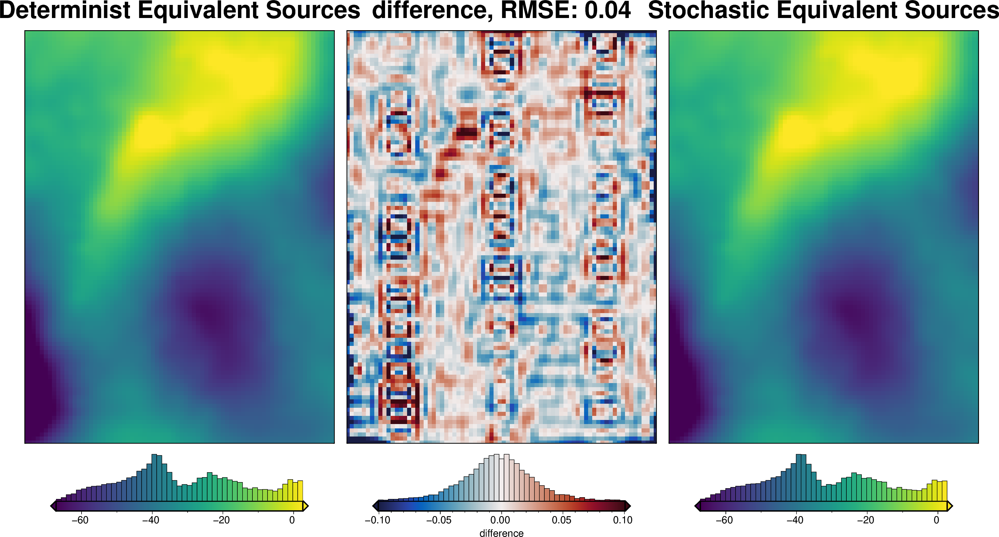

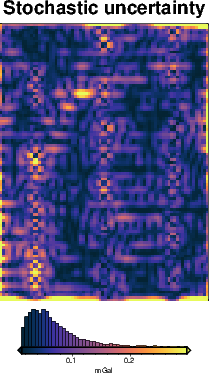

In [78]:
grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()
_ = polar_utils.grd_compare(
    grav_grid.gravity_anomaly,
    grav_grid.gravity_anomaly_eqs_mean,
    region=inversion_region,
    plot=True,
    grid1_name="Determinist Equivalent Sources",
    grid2_name="Stochastic Equivalent Sources",
    robust=True,
    hist=True,
    inset=False,
    verbose="q",
    title="difference",
    grounding_line=False,
)
maps.plot_grd(
    grav_grid.eqs_uncert,
    region=inversion_region,
    fig_height=10,
    title="Stochastic uncertainty",
    cmap="thermal",
    hist=True,
    robust=True,
    cbar_label="mGal",
)

In [79]:
# update grav_df and rename columns
grav_df_eqs = grav_df.copy()
grav_df_eqs = grav_df_eqs.rename(
    columns={
        "gravity_anomaly": "gravity_anomaly_deterministic",
        "uncert": "uncert_constant",
    }
)
grav_df_eqs["gravity_anomaly"] = grav_df_eqs.gravity_anomaly_eqs_mean
grav_df_eqs["uncert"] = grav_df_eqs.eqs_uncert

uncert_kwargs["grav_df"] = grav_df_eqs

In [80]:
grav_df_eqs = regional.regional_separation(
    grav_df=grav_df_eqs,
    **new_regional_grav_kwargs,
)
# kwargs to reuse for all uncertainty analyses
eqs_uncert_kwargs = dict(
    grav_df=grav_df_eqs,
    density_contrast=best_density_contrast,
    zref=zref,
    starting_prisms=starting_prisms,
    starting_topography=starting_bathymetry,
    regional_grav_kwargs=new_regional_grav_kwargs,
    **kwargs,
)

In [81]:
# save to csv
grav_df_eqs.to_csv(f"{fpath}_grav_df.csv", index=False)

INFO:invert4geom:No pickle files starting with '../results/Ross_Sea/Ross_Sea_05_uncertainty_eq_sources' found, creating new files



stochastic ensemble:   0%|          | 0/10 [00:00<?, ?it/s]

INFO:invert4geom:starting stochastic uncertainty analysis at run 0 of 10
saving results to pickle files with prefix: '../results/Ross_Sea/Ross_Sea_05_uncertainty_eq_sources'



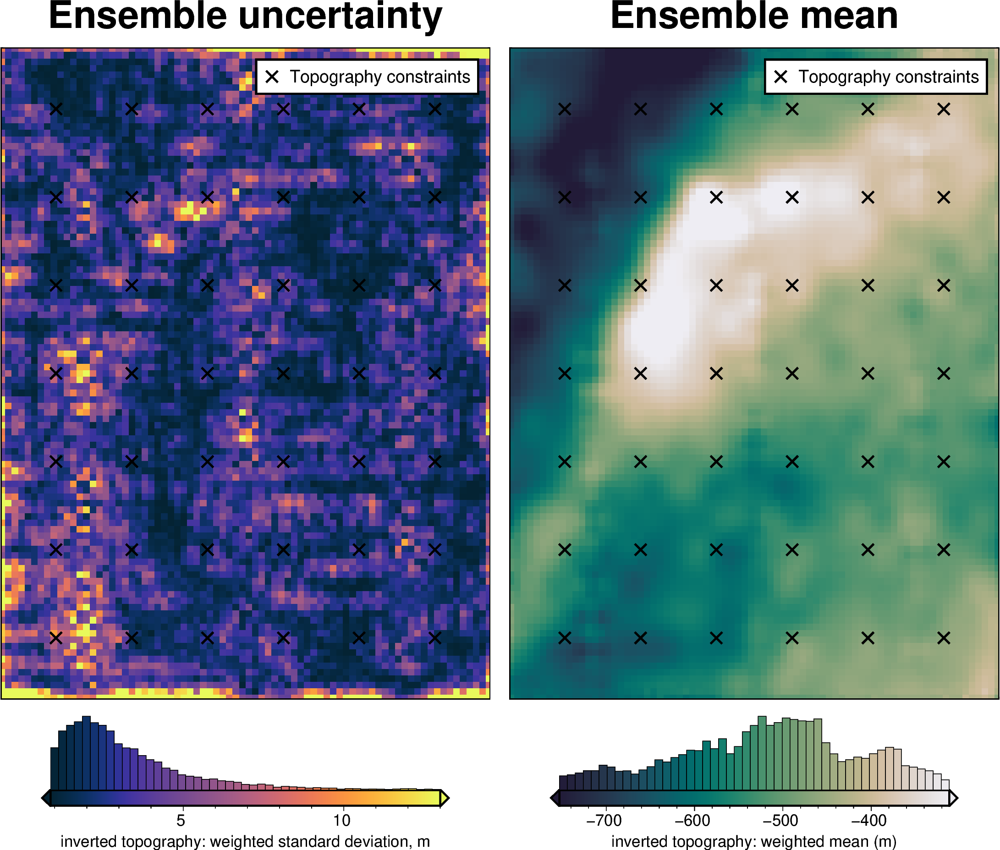

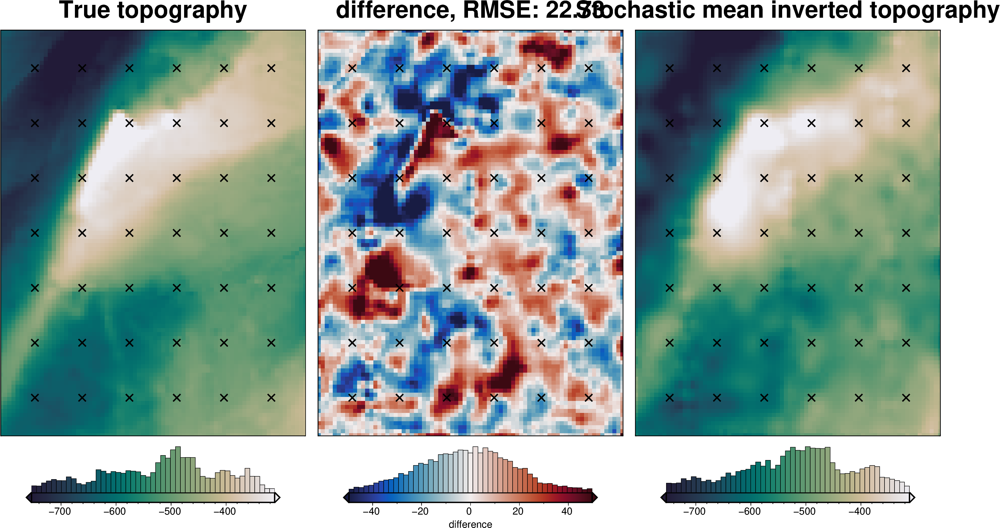

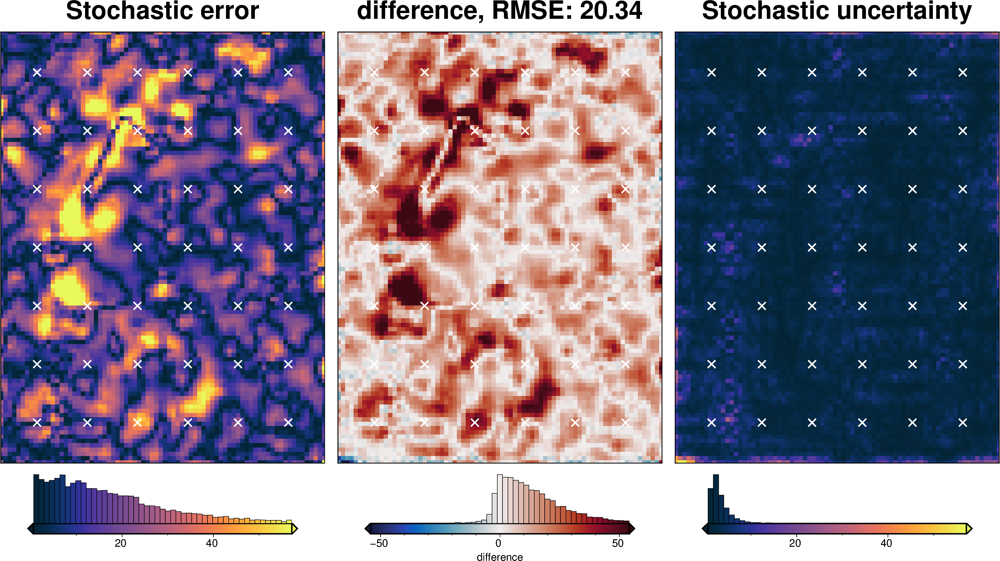

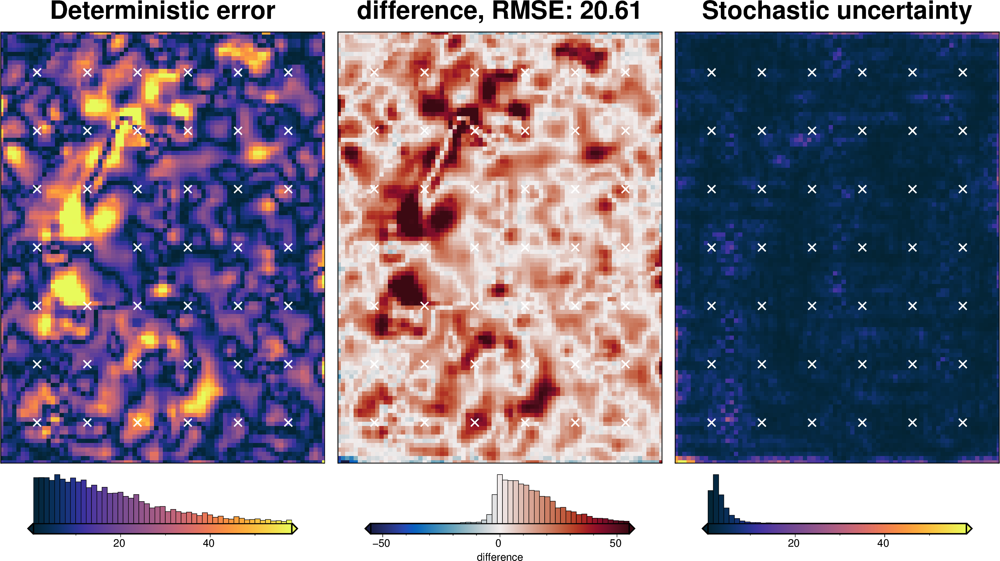

In [82]:
fname = f"{fpath}_uncertainty_eq_sources"

# delete files if already exist
for p in pathlib.Path().glob(f"{fname}*"):
    p.unlink(missing_ok=True)

uncert_eq_sources_results = uncertainty.full_workflow_uncertainty_loop(
    fname=fname,
    runs=10,
    sample_gravity=True,
    **eqs_uncert_kwargs,
)

stats_ds = synth_plotting.uncert_plots(
    uncert_eq_sources_results,
    # vd.pad_region(inversion_region, -3*spacing),
    inversion_region,
    bathymetry,
    deterministic_bathymetry=final_topography,
    constraint_points=constraint_points[constraint_points.inside],
    weight_by="constraints",
    # weight_by="residual",
    # weight_by=None,
)

## Total uncertainty
The total uncertainty includes uncertainty arising from several source. Below we list these and state how they are accounted for:
* solver damping value -> solver_dict
* density contrast value -> density_dict
* random errors in the constraint point depths -> not accounted for
* random errors in the gravity data -> point-by-point sampling of gravity data with constant estimated uncertainty value
* errors from interpolating flight lines into a grid -> standard deviation of equivalent source gridding ensemble used for point-by-point uncertainty
* errors from regional field estimation -> regional_misfit_parameter_dict

In [83]:
# make min gravity uncertainty the value used to contaminate the original grid
grav_df_eqs["uncert"] = np.maximum(grav_df_eqs.uncert, gravity_noise)

grav_df_eqs = regional.regional_separation(
    grav_df=grav_df_eqs,
    **new_regional_grav_kwargs,
)

# kwargs to reuse for all uncertainty analyses
eqs_uncert_kwargs = dict(
    grav_df=grav_df_eqs,
    density_contrast=best_density_contrast,
    zref=zref,
    starting_prisms=starting_prisms,
    starting_topography=starting_bathymetry,
    regional_grav_kwargs=new_regional_grav_kwargs,
    **kwargs,
)

makecpt [ERROR]: Option T: min >= max
ERROR:polartoolkit:Module 'makecpt' failed with status code 72:
makecpt [ERROR]: Option T: min >= max
Traceback (most recent call last):
  File "/home/sungw937/polartoolkit/src/polartoolkit/maps.py", line 1026, in set_cmap
    pygmt.makecpt(
  File "/home/sungw937/miniforge3/envs/synthetic_bathymetry_inversion/lib/python3.12/site-packages/pygmt/helpers/decorators.py", line 595, in new_module
    return module_func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/sungw937/miniforge3/envs/synthetic_bathymetry_inversion/lib/python3.12/site-packages/pygmt/helpers/decorators.py", line 758, in new_module
    return module_func(*bound.args, **bound.kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/sungw937/miniforge3/envs/synthetic_bathymetry_inversion/lib/python3.12/site-packages/pygmt/src/makecpt.py", line 164, in makecpt
    lib.call_module(module="makecpt", args=build_arg_list(kwargs, outfile=output))
  Fi

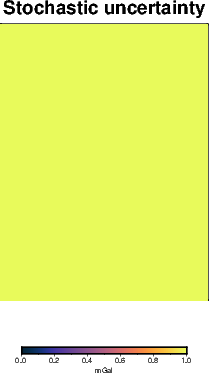

In [84]:
grav_grid = grav_df_eqs.set_index(["northing", "easting"]).to_xarray()

maps.plot_grd(
    grav_grid.uncert,
    region=inversion_region,
    fig_height=10,
    title="Stochastic uncertainty",
    cmap="thermal",
    hist=True,
    robust=True,
    cbar_label="mGal",
)

INFO:invert4geom:Sampled 'solver_damping' parameter values; mean: 0.015423971646509368, min: 0.004591021082568975, max: 0.039242130312217544
INFO:invert4geom:Sampled 'density_contrast' parameter values; mean: 2025.0, min: 1045.0180077299729, max: 3004.981992270028
INFO:invert4geom:No pickle files starting with '../results/Ross_Sea/Ross_Sea_05_uncertainty_full' found, creating new files



stochastic ensemble:   0%|          | 0/20 [00:00<?, ?it/s]

INFO:invert4geom:starting stochastic uncertainty analysis at run 0 of 20
saving results to pickle files with prefix: '../results/Ross_Sea/Ross_Sea_05_uncertainty_full'



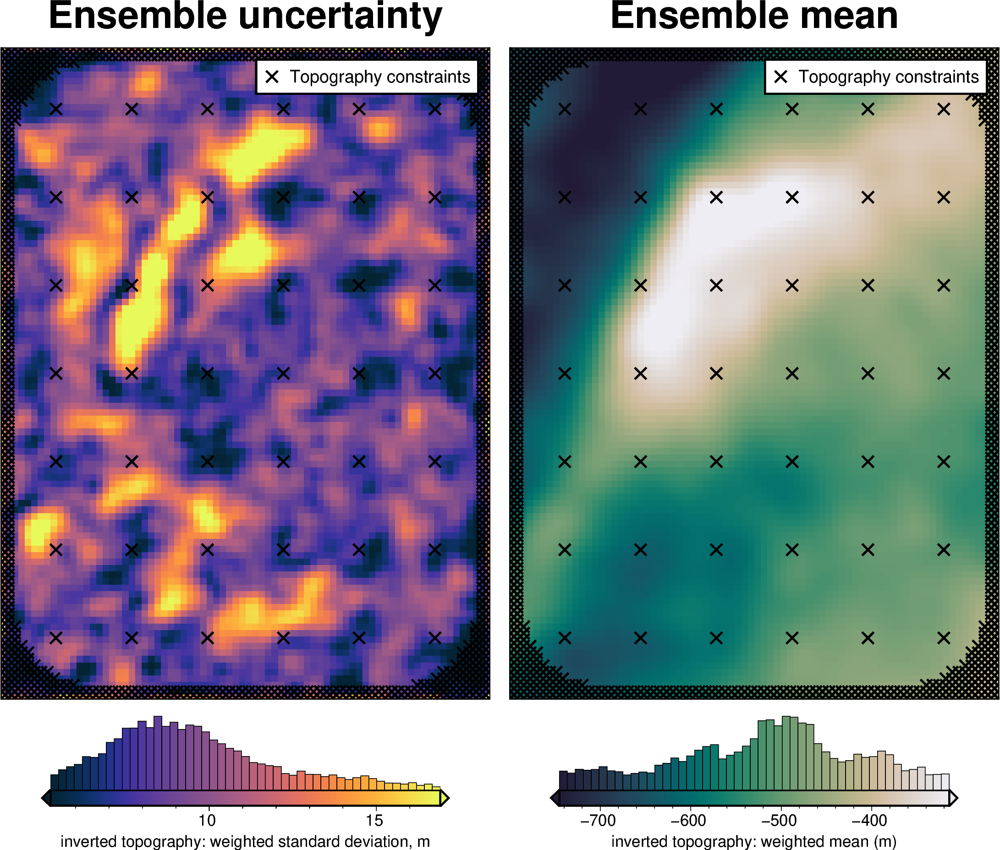

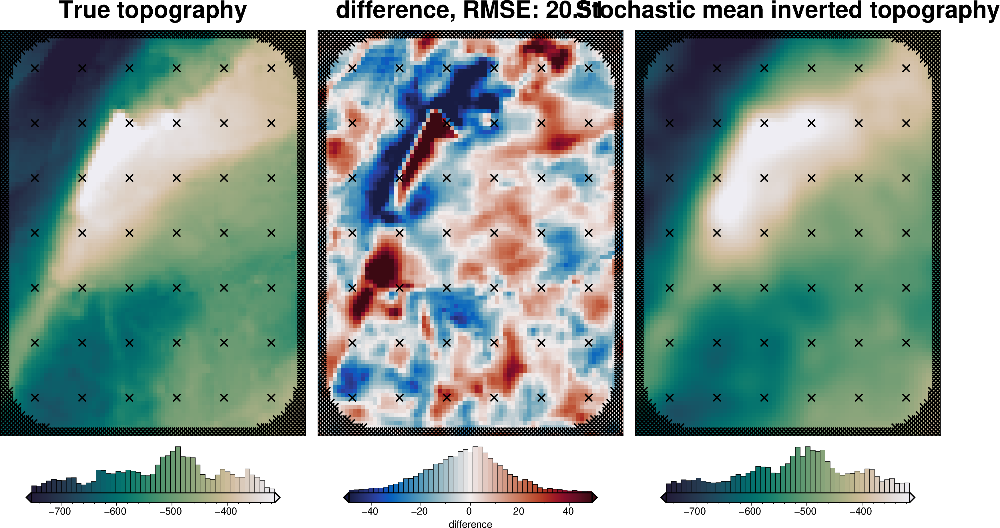

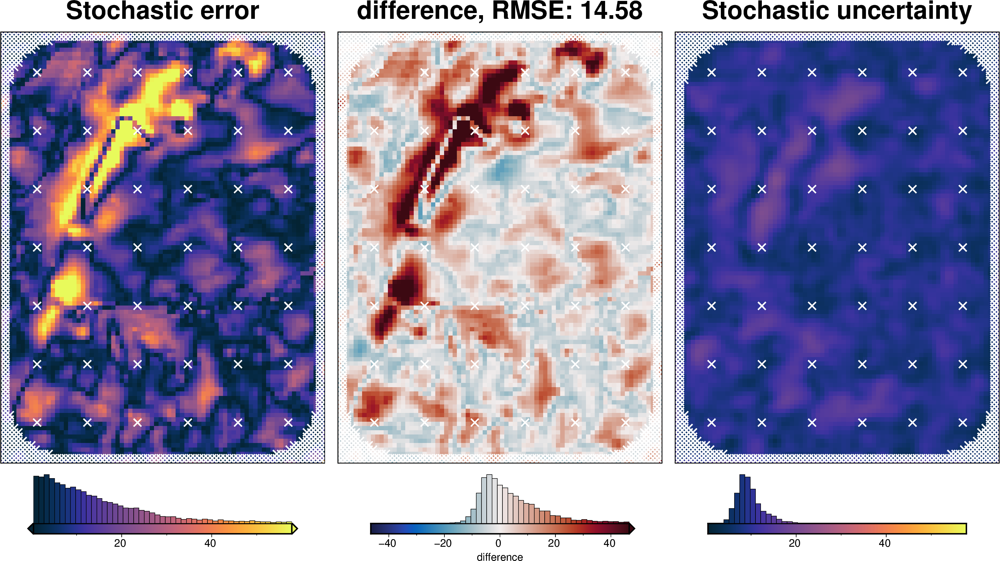

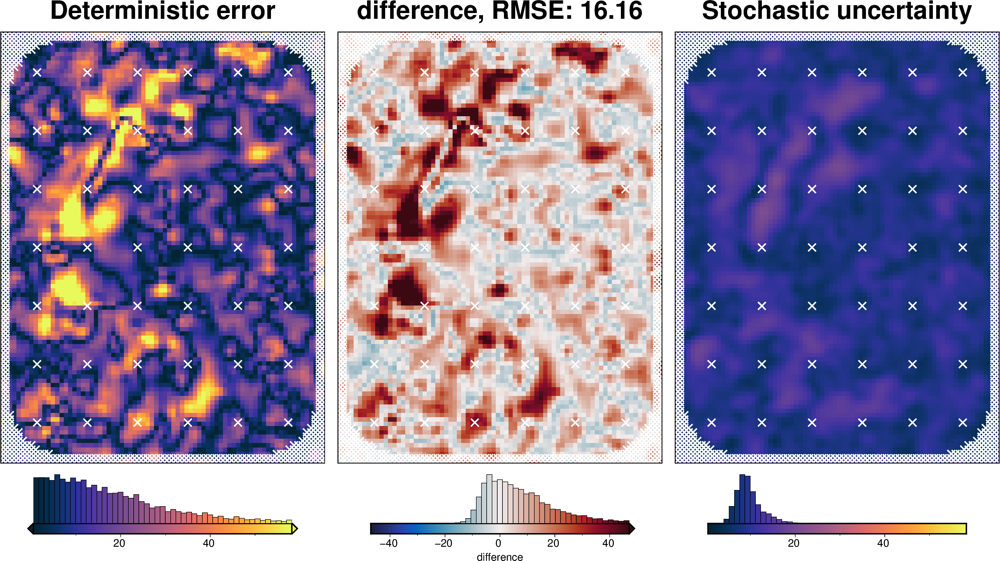

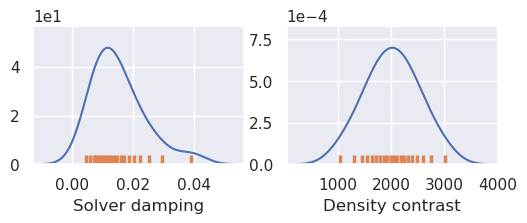

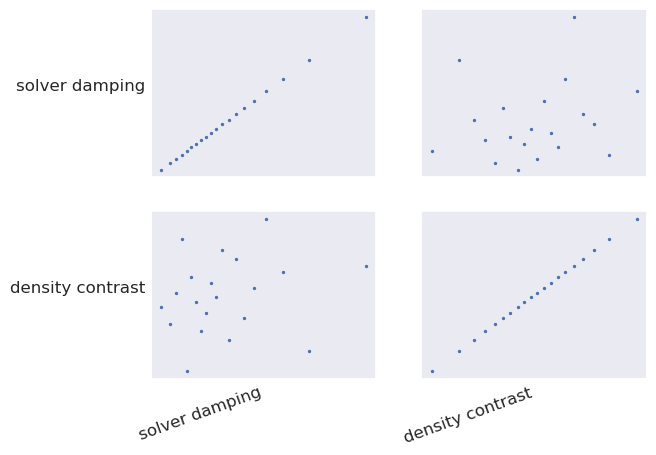

In [85]:
fname = f"{fpath}_uncertainty_full"

# delete files if already exist
for p in pathlib.Path().glob(f"{fname}*"):
    p.unlink(missing_ok=True)

uncert_results = uncertainty.full_workflow_uncertainty_loop(
    fname=fname,
    runs=20,
    sample_gravity=True,
    # sample_constraints=True,
    # constraints_df=constraint_points,
    gravity_filter_width=filt_width,
    parameter_dict=solver_dict | density_dict,
    # regional_misfit_parameter_dict=regional_misfit_parameter_dict,
    # starting_topography_kwargs=starting_topography_kwargs,
    **eqs_uncert_kwargs,
)

stats_ds = synth_plotting.uncert_plots(
    uncert_results,
    # vd.pad_region(inversion_region, -3*spacing),
    inversion_region,
    bathymetry,
    deterministic_bathymetry=final_topography,
    constraint_points=constraint_points,
    weight_by="constraints",
    # weight_by="residual",
    # weight_by=None,
)

plotting.plot_latin_hypercube(
    uncert_results[-1],
)

### Comparing results

In [86]:
results = [
    uncert_results,
    uncert_eq_sources_results,
    # uncert_regional_results,
    uncert_grav_results,
    # uncert_constraints_results,
    uncert_density_results,
    uncert_damping_results,
]
names = [
    "full",
    "eq_sources",
    # "regional",
    "grav",
    # "constraints",
    "density",
    "damping",
]

# get cell-wise stats for each ensemble
stats = []
for r in results:
    ds = uncertainty.merged_stats(
        results=r,
        plot=False,
        constraints_df=constraint_points,
        weight_by="constraints",
        # region=vd.pad_region(inversion_region, -spacing),
        region=inversion_region,
    )
    stats.append(ds)

In [87]:
# get the standard deviation of the ensemble of ensembles
stdevs = []
for i, s in enumerate(stats):
    stdevs.append(s.weighted_stdev.rename(f"{names[i]}_stdev"))

merged = xr.merge(stdevs)
merged

<xarray.Dataset> Size: 308kB
Dimensions:           (northing: 101, easting: 76)
Coordinates:
  * northing          (northing) float64 808B -1.6e+06 -1.598e+06 ... -1.4e+06
  * easting           (easting) float64 608B -4e+04 -3.8e+04 ... 1.1e+05
Data variables:
    full_stdev        (northing, easting) float64 61kB 17.69 9.403 ... 17.12
    eq_sources_stdev  (northing, easting) float64 61kB 47.31 68.8 ... 28.87 29.1
    grav_stdev        (northing, easting) float64 61kB 18.05 7.504 ... 16.0
    density_stdev     (northing, easting) float64 61kB 0.7296 0.9874 ... 7.258
    damping_stdev     (northing, easting) float64 61kB 2.394 1.143 ... 7.617

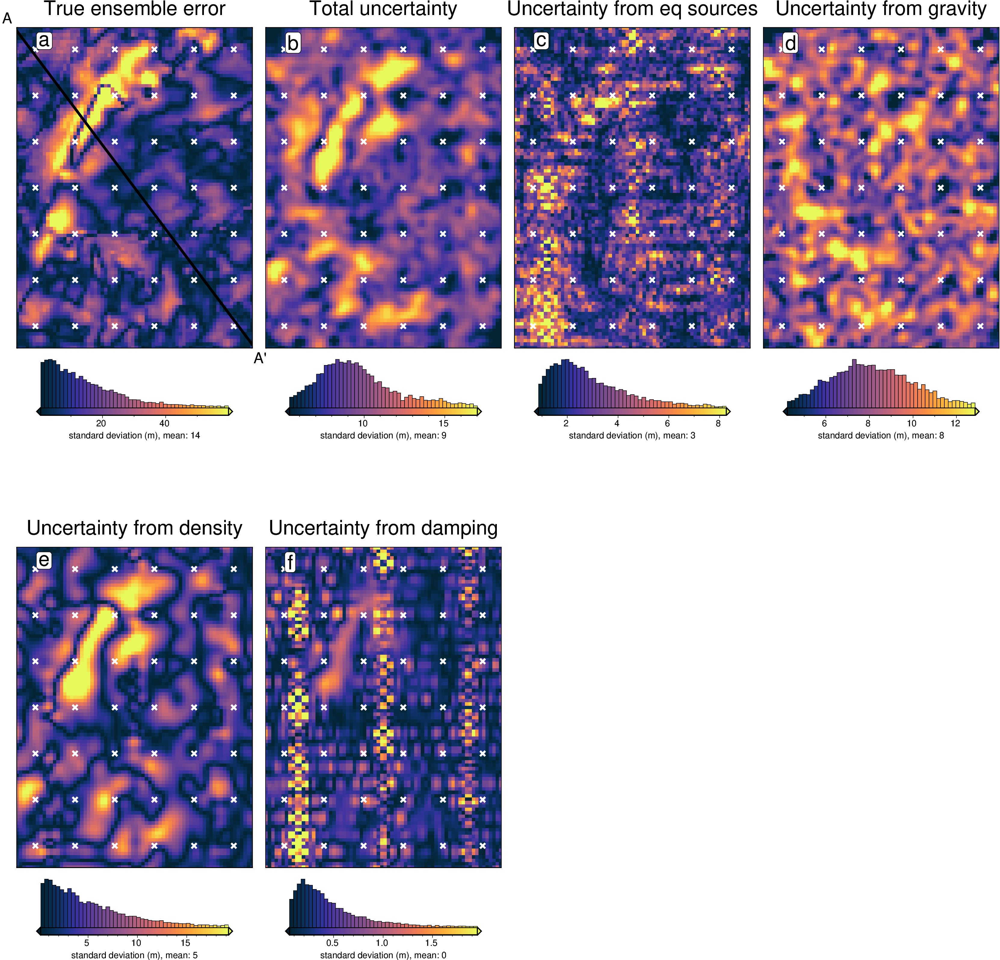

In [88]:
titles = [
    "True ensemble error",
    "Total uncertainty",
    "Uncertainty from eq sources",
    # "Uncertainty from regional",
    "Uncertainty from gravity",
    # "Uncertainty from constraints",
    "Uncertainty from density",
    "Uncertainty from damping",
]
grids = list(merged.data_vars.values())

grids.insert(0, np.abs(stats[0].weighted_mean - bathymetry))

cpt_lims = polar_utils.get_min_max(
    grids[0],
    robust=True,
)
# cpt_lims = polar_utils.get_combined_min_max(grids, robust=True)

fig_height = 9
for i, g in enumerate(grids):
    xshift_amount = 1
    if i == 0:
        fig = None
        origin_shift = "initialize"
    elif i == 4:
        origin_shift = "both_shift"
        xshift_amount = -3
    else:
        origin_shift = "xshift"

    fig = maps.plot_grd(
        grid=g,
        fig_height=fig_height,
        region=vd.pad_region(inversion_region, -3 * spacing),
        title=titles[i],
        title_font="16p,Helvetica,black",
        cmap="thermal",
        # cpt_lims=cpt_lims,
        robust=True,
        cbar_label=f"standard deviation (m), mean: {int(np.nanmean(g))}",
        hist=True,
        hist_bin_num=50,
        fig=fig,
        origin_shift=origin_shift,
        xshift_amount=xshift_amount,
        yshift_amount=-1.1,
    )
    fig.plot(
        x=constraint_points[constraint_points.inside].easting,
        y=constraint_points[constraint_points.inside].northing,
        style="x.2c",
        fill="white",
        pen="1.5p,white",
    )
    fig.text(
        position="TL",
        text=f"{string.ascii_lowercase[i]}",
        fill="white",
        pen=True,
        font="16p,Helvetica,black",
        offset="j.6/.2",
        clearance="+tO",
        no_clip=True,
    )
    if i == 0:
        # plot profiles location, and endpoints on map
        start = [inversion_region[0], inversion_region[3]]
        stop = [inversion_region[1], inversion_region[2]]
        fig.plot(
            vd.line_coordinates(start, stop, size=100),
            pen="2p,black",
        )
        fig.text(
            x=start[0],
            y=start[1],
            text="A",
            fill="white",
            font="12p,Helvetica,black",
            justify="CM",
            clearance="+tO",
            no_clip=True,
        )
        fig.text(
            x=stop[0],
            y=stop[1],
            text="A' ",
            fill="white",
            font="12p,Helvetica,black",
            justify="CM",
            clearance="+tO",
            no_clip=True,
        )
fig.show()

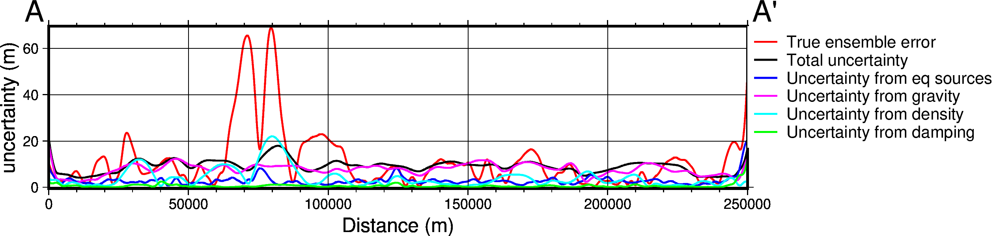

In [89]:
data_dict = profiles.make_data_dict(
    names=titles,
    grids=grids,
    colors=[
        "red",
        "black",
        "blue",
        "magenta",
        "cyan",
        "green",
        "purple",
        "gray",
    ],
)

fig, df_data = profiles.plot_data(
    "points",
    start=[inversion_region[0], inversion_region[3]],
    stop=[inversion_region[1], inversion_region[2]],
    num=10000,
    fig_height=4,
    fig_width=15,
    data_dict=data_dict,
    data_legend_loc="jTR+jTL",
    data_legend_box="+gwhite",
    data_buffer=0.01,
    data_frame=["neSW", "xafg+lDistance (m)", "yag+luncertainty (m)"],
    # data_pen_style=[None,None,"4_2:2p"],
    # data_pen_thickness=[1, 1.5, 1],
    share_yaxis=True,
    start_label="A",
    end_label="A' ",
)
fig.show()

In [90]:
# save results
merged.to_netcdf(f"{fpath}_sensitivity.nc")

In [91]:
stats_ds.to_netcdf(f"{fpath}_uncertainty.nc")